# FLattice_PBH Simulation Results
---
## Parameter Set: Modified version of Takayama Journal Paper FIG1(a) 
---
### Simulations

1. **Zero mode simulation**
    - Calculates only the zero modes w/o perturbations for a specified wavenumber mode.
1. **Non-lattice simulation**
    - Calculates zero modes w/ linear perturbations for specified range of wavenumber modes. Lattice simulation is ignored.
1. **Lattice simulation**
    - Calculates zero modes w/ perturbations using lattice simulation for specified range of wavenumber modes.
---
### Table of Contents
1. **Zero mode simulation results**
1. **Non-lattice simulation and zero mode simulation results comparison**
1. **Power spectrums of non-lattice simulation**  
1. **Mode functions of non-lattice simulation right before oscillation period starts**  
1. **Linear perturbation variables of non-lattice simulation right before oscillation period starts** 
1. **Lattice simulation and zero mode simulation results comparison**
1. **Additional plots of variables in lattice simulation** 
1. **Comparison of non-lattice and lattice simulation results of power spectrums of different variables**
1. **Power spectrums of different variables during lattice simulation**
1. **Power spectrums of curvature perturbation with different parameters for the lattice simulation case**
1. **Comparison of non-lattice and lattice simulation results for a specific mode**
---
---

In [80]:
parset_name = "Modver_TakayamaJournalPaperFIG1a"

OSCSTART = -113.262
UNPERT = -109. 

## 1. Zero mode simulation results
---
   #### Target mode for calculating general zero mode variables:  knum = 700 (k = 1000\[Mpc$^{-1}$\])
   #### Target modes for calculating k/aH:  knum = {200, 400, 634, 700} 

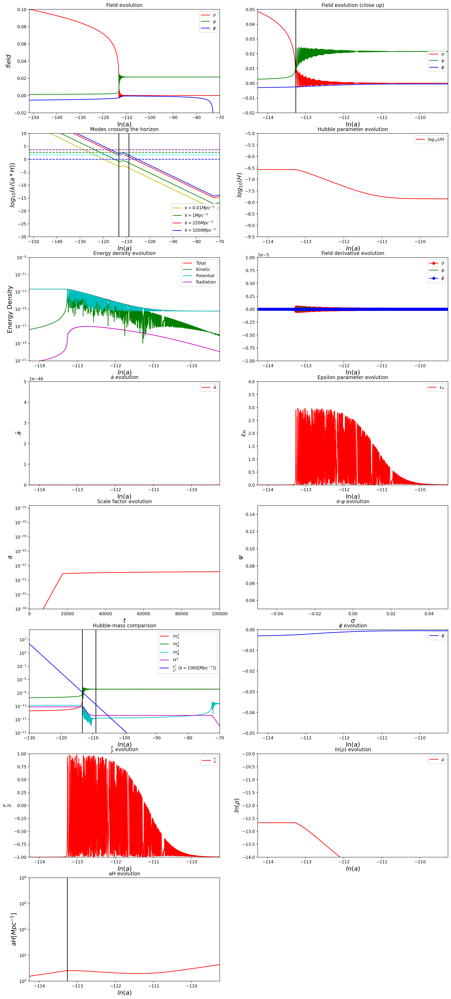

In [123]:
%matplotlib inline
%config InlineBackend.figure_formats = {'png', 'retina'}
import math
import numpy as np
import matplotlib.pyplot as plt

time, loga, sigma, psi, phi,sigma_dot, psi_dot, phi_dot, w, rho, kinetic, potential, radiation, adotdot, epsilon,\
msigma, mpsi, mphi, hubble, dVsigma, dVpsi, dVphi, pdivrho, kdiva, mode200, mode400, mode634,mode700 \
= np.loadtxt(parset_name + "/zs_true/zeromode.txt",  unpack=True) 

fig = plt.figure(figsize=(18, 42))# figsize=(width, height)
graphrow, graphcolumn = 8, 2


#Field evolution 
ax = fig.add_subplot(graphrow, graphcolumn, 1)
ax.plot(loga, sigma, "-", color="r", label=r"$ \sigma  $")
ax.plot(loga, psi, "-", color="g", label=r"$ \psi  $")
ax.plot(loga, phi, "-", color="b", label=r"$ \phi  $")
# ax.set_xlim(0, 10000)
ax.set_xlim(loga[0], loga[-1])
ax.set_ylim(-0.02, 0.1)
ax.set_xlabel("ln(a)", size = 15)
ax.set_ylabel(r"$ field $", size = 15)
ax.legend(loc="upper right")
ax.set_title('Field evolution')

#Field evolution　(close up)
bx = fig.add_subplot(graphrow, graphcolumn, 2)
bx.plot(loga, sigma, "-", color="r", label=r"$ \sigma  $")
bx.plot(loga, psi, "-", color="g", label=r"$ \psi  $")
bx.plot(loga, phi, "-", color="b", label=r"$ \phi  $")
# bx.set_xlim(0, 1000)
bx.axvline(x=OSCSTART, color='k')
bx.set_xlim(OSCSTART-1, OSCSTART+4)
bx.set_ylim(-0.02, 0.05)
bx.set_xlabel("ln(a)", size = 15)
bx.set_ylabel(r" ", size = 15)
bx.legend(loc="right")
bx.set_title('Field evolution (close up)')

#Modes crossing the horizon
cx = fig.add_subplot(graphrow, graphcolumn, 3)
cx.plot(loga, mode200 , "-", color="y", label=r"$ k= 0.01Mpc^{-1} $")
cx.plot(loga, mode400 , "-", color="g", label=r"$ k= 1Mpc^{-1} $")
cx.plot(loga, mode634 , "-", color="r", label=r"$ k=  220Mpc^{-1} $")
cx.plot(loga, mode700 , "-", color="b", label=r"$ k= 1000Mpc^{-1}$")
cx.hlines([0], loga[0], loga[-1], "blue", linestyles='dashed')
cx.hlines([math.log10(50)], loga[0],  loga[-1], "cyan", linestyles='dashed')
cx.hlines([math.log10(500)], loga[0],  loga[-1], "green", linestyles='dashed')
cx.hlines([math.log10(5000)], loga[0],  loga[-1], "purple", linestyles='dashed')
cx.axvline(x=OSCSTART, color='k')
# cx.axvline(x=OSCEND, color='k')
cx.axvline(x=UNPERT, color='k')
# cx.set_xlim(0, 1000)
cx.set_xlim(loga[0],  loga[-1])
cx.set_ylim(-30, 10)
cx.set_xlabel("$ln(a)$", size = 15)
cx.set_ylabel(r"$ log_{10}(k/(a*H)) $", size = 15)
#cx.set_yticks(np.arange(1.42672*math.sqrt(2)-0.05,1.42672*math.sqrt(2)+ 0.10,0.01) )
cx.legend(loc="lower right")
cx.set_title('Modes crossing the horizon')

#Hubble parameter evolution
dx = fig.add_subplot(graphrow, graphcolumn, 4)
dx.plot(loga, w , "-", color="r", label=r"$ log_{10}(H)  $")
# dx.set_xlim(0, 1000)
dx.set_xlim(OSCSTART-1, OSCSTART+4)
dx.set_ylim(-9.5, -5)
dx.set_xlabel("$ln(a)$", size = 15)
dx.set_ylabel(r"$ log_{10}(H)  $", size = 15)
#dx.set_yticks(np.arange(1.42672*math.sqrt(2)-0.05,1.42672*math.sqrt(2)+ 0.10,0.01) )
dx.legend(loc="upper right")
dx.set_title('Hubble parameter evolution')

#Energy density evolution
ex = fig.add_subplot(graphrow, graphcolumn,5)
ex.plot(loga, rho , "-", color="r",label=r' Total')
# ex.plot(scalefactor, 3*hubble*hubble, "-", color="b",label=r' $3H^{2}$')
ex.plot(loga, kinetic , "-", color="g",label=r' Kinetic')
ex.plot(loga, potential , "-", color="c",label=r' Potential')
ex.plot(loga, radiation, "-", color="m",label=r' Radiation')
ex.legend(loc="upper right")
ex.set_xlim(OSCSTART-1, OSCSTART+4)
ex.set_ylim(pow(10,-21), pow(10,-9))
ex.set_yscale("log")
ex.set_xlabel("$ln(a)$", size = 15)
ex.set_ylabel("Energy Density", size = 15)
ex.set_title('Energy density evolution')

#Field derivative evolution
fx = fig.add_subplot(graphrow, graphcolumn, 6)
fx.plot(loga, sigma_dot, "-", color="r", label=r"$ \dot{\sigma}  $", marker='o')
fx.plot(loga, psi_dot, "-", color="g", label=r"$ \dot{\psi } $")
fx.plot(loga, phi_dot, "-", color="b", label=r"$ \dot{\phi}  $", marker='o')
# fx.set_xlim(0, 10000)
fx.set_xlim(OSCSTART-1, OSCSTART+4)
fx.set_ylim(-pow(10,-5), pow(10,-5))
fx.set_xlabel("ln(a)", size = 15)
fx.set_ylabel(r" ", size = 15)
#fx.set_yticks(np.arange(1.42672*math.sqrt(2)-0.05,1.42672*math.sqrt(2)+ 0.10,0.01) )
fx.legend(loc="upper right")
fx.set_title('Field derivative evolution')

#adotdot evolution
gx = fig.add_subplot(graphrow, graphcolumn,7)
gx.plot(loga, adotdot , "-", color="r",label=r'$ \ddot{a}$')
gx.legend(loc="upper right")
gx.set_xlim(OSCSTART-1, OSCSTART+4)
gx.set_ylim(-9*pow(10,-62), 5*pow(10,-46))
gx.set_xlabel("ln(a)", size = 15)
gx.set_ylabel(r'$ \ddot{a} $', size = 15)
gx.set_title('$\ddot{a}$ evolution')

#epsilon evolution
hx = fig.add_subplot(graphrow, graphcolumn,8)
hx.plot(loga, epsilon , "-", color="r",label=r'$ \epsilon_{H} $')
hx.legend(loc="upper right")
hx.set_xlim(OSCSTART-1, OSCSTART+4)
hx.set_ylim(0,4)
hx.set_xlabel("ln(a)", size = 15)
hx.set_ylabel(r'$ \epsilon_{H} $', size = 15)
hx.set_title('Epsilon parameter evolution')

a = np.exp(loga)

#scale factor evolution
ix=fig.add_subplot(graphrow, graphcolumn, 9)
ix.plot(time, a, "-", color="r",label='')
# ix.legend(loc="upper right")
ix.set_xlim(0, 100000)
# ix.set_yticks(np.arange(pow(10,-59),5*pow(10,-31),pow(10,-59)))
ix.set_ylim(pow(10,-59),5*pow(10,-31))
ix.set_yscale("log")
ix.set_xlabel(r'$ t$', size = 15)
ix.set_ylabel(r'$ a$', size = 15)
ix.set_title('Scale factor evolution')

#sigma-psi evolution
jx = fig.add_subplot(graphrow, graphcolumn, 10)
jx.plot( sigma,  psi, "-", color="r",label=' ')#-1.42672*math.sqrt(2)
# plt.axhline(y=2.066968-2.0224, color='k', linestyle='-')
# jx.set_xlim(f_average_sigma[-1], f_average_sigma[0])
# jx.set_ylim( f_average_psi[-1], f_average_psi[0])
jx.set_xlim(-0.05, 0.05)
jx.set_ylim(0.03, 0.15)
jx.set_xlabel(r"$  \sigma $", size = 15)
jx.set_ylabel(r"$   \psi $", size = 15)
jx.set_title("$\sigma$-$\psi$ evolution")
#jx.set_ylabel(r"$  \langle \phi \rangle - \phi_{\rm min}$", size = 15)
#jx.set_yticks(np.arange(1.42672*math.sqrt(2)-0.05,1.42672*math.sqrt(2)+ 0.10,0.01) )
#jx.legend(loc="upper right")

#Hubble-mass comparison
kx = fig.add_subplot(graphrow, graphcolumn, 11)
# kx.plot(scalefactor, 3*hubble*hubble, "-", color="b",label=r' $3H^{2}$')
kx.plot(loga, abs(msigma) , "-", color="r",label=r' $m_{\sigma}^{2}$')
kx.plot(loga, abs(mpsi) , "-", color="g",label=r' $m_{\psi}^{2}$')
kx.plot(loga, abs(mphi), "-", color="c",label=r' $m_{\phi}^{2}$')
kx.plot(loga, hubble*hubble, "-", color="m",label=r' $H^{2}$')
kx.plot(loga, kdiva*kdiva, "-", color="b",label=r' $\frac{k^{2}}{a^{2}} \  (k = 1000[Mpc^{-1}])$')
kx.axvline(x=OSCSTART, color='k')
# kx.axvline(x=OSCEND, color='k')
kx.axvline(x=UNPERT, color='k')
kx.legend(loc="upper right")
kx.set_xlim(-130, -70)
kx.set_ylim(pow(10,-21),pow(10,10))
kx.set_yscale("log")
kx.set_xlabel("$ln(a)$", size = 15)
kx.set_ylabel("", size = 15)
kx.set_title("Hubble-mass comparison")


#psi evolution
lx = fig.add_subplot(graphrow, graphcolumn, 12)
# lx.plot(loga, sigma_dot, "-", color="r", label=r"$ \dot{\sigma}  $", marker='o')
# lx.plot(loga, psi_dot, "-", color="g", label=r"$ \dot{\psi } $")
lx.plot(loga, phi, "-", color="b", label=r"$ \phi   $")
# lx.set_xlim(0, 10000)
lx.set_xlim(OSCSTART-1, OSCSTART+4)
lx.set_ylim(-0.05, 0)
lx.set_xlabel("ln(a)", size = 15)
lx.set_ylabel(r"", size = 15)
#lx.set_yticks(np.arange(1.42672*math.sqrt(2)-0.05,1.42672*math.sqrt(2)+ 0.10,0.01) )
lx.legend(loc="upper right")
lx.set_title(r"$\phi$ evolution")

#p/rho evolution
mx = fig.add_subplot(graphrow, graphcolumn, 13)
mx.plot(loga, pdivrho , "-", color="r", label=r"$ \frac{P}{\rho}   $")
# mx.set_xlim(0, 1000)
mx.set_xlim(OSCSTART-1, OSCSTART+4)
mx.set_ylim(-1, 1)
mx.set_xlabel("$ln(a)$", size = 15)
mx.set_ylabel(r"$\frac{P}{\rho}$", size = 15)
mx.legend(loc="upper right")
mx.set_title(r"$\frac{P}{\rho}$ evolution")

logrho = np.log10(rho)

#ln(rho) evolution
nx = fig.add_subplot(graphrow, graphcolumn, 14)
nx.plot(loga, logrho , "-", color="r", label=r"$ \rho  $")
nx.set_xlim(OSCSTART-1, OSCSTART+4)
nx.set_ylim(-14, -10)
nx.set_xlabel("$ln(a)$", size = 15)
nx.set_ylabel(r"$ln(\rho)   $", size = 15)
nx.legend(loc="upper right")
nx.set_title(r"$ln(\rho)$ evolution")

aH_MPl = a * hubble
Ck = 2.626E-61
aH_Mpc = np.power(10.0, np.log10(aH_MPl/Ck) - 4)
#aH evolution
ox=fig.add_subplot(graphrow, graphcolumn, 15)
ox.plot(loga, aH_Mpc, "-", color="r",label='')
ox.axvline(x=OSCSTART, color='k')
# ox.axvline(x=OSCEND, color='k')
ox.axvline(x=UNPERT, color='k')
# ox.legend(loc="upper right")
ox.set_xlim(OSCSTART-1, OSCSTART+4)
# ox.set_yticks(np.arange(pow(10,-59),5*pow(10,-31),pow(10,-59)))
ox.set_ylim(pow(10,0),pow(10,8))
ox.set_yscale("log")
ox.set_xlabel(r'$ ln(a)$', size = 15)
ox.set_ylabel(r'$ aH [Mpc^{-1}]$', size = 15)
ox.set_title(r'$aH$ evolution')


plt.show()

## 2. Non-lattice simulation and zero mode simulation results comparison
---
  #### Calculated mode range for non-lattice simulation: 
  - Minimum: kfrom_Mpc = $10^{-4}$ (knum = 0)
  - Max: kto_Mpc = $10^{4}$ (knum = 800)
  - Interval: kinterval_knum = 1
  #### target mode for comparison:   
  - Zero mode simulation results: knum = 700
  -  Non-lattice simulation results: Choosable from knum = 0, 1,...,800

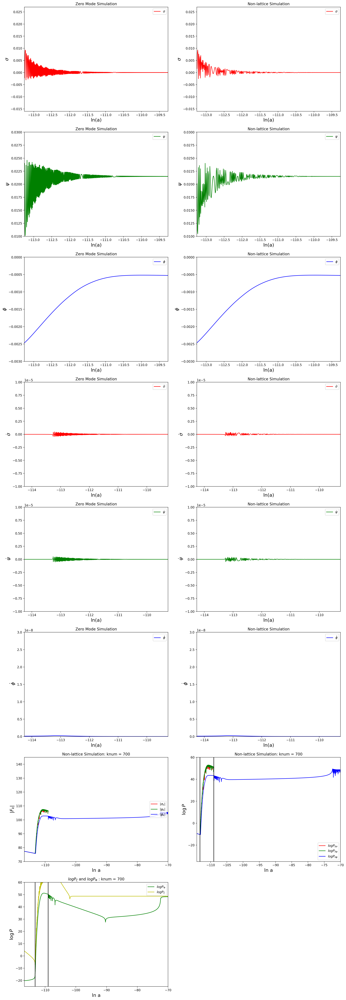

In [97]:
%matplotlib inline
%config InlineBackend.figure_formats = {'png', 'retina'}
import math
import numpy as np
import matplotlib.pyplot as plt


#Target mode for non-lattice simulation
knum =  700

time_z, loga_z, sigma_z, psi_z, phi_z,sigma_dot_z, psi_dot_z, phi_dot_z, w_z, rho_z, kinetic_z, potential_z, radiation_z, adotdot_z, epsilon_z,\
msigma_z, mpsi_z, mphi_z, hubble_z, dVsigma_z, dVpsi_z, dVphi_z, pdivrho_z, kdiva_z, mode200_z, mode400_z, mode634_z, mode700_z \
= np.loadtxt(parset_name + "/zs_true/zeromode.txt",  unpack=True) 

condition_name = "zs_true-ps_true-ls_false-lks_false-kfrom_0.0001-kto_10000.0-iknum_1"
loga, w, Pzeta, Pzeta, PPot, Psigma, Ppsi, Pphi, log10_dsigma, log10_dpsi, log10_dphi, sigma, psi, phi, sigma_dot, psi_dot, phi_dot \
= np.loadtxt(parset_name + "/" + condition_name + "/k-analyze_nonlattice/knum_0" + str(knum) + ".txt", \
             usecols = (0, 1, 2, 3, 4, 8, 9, 10,11,12,13,20,21,22,23,24,25), unpack=True)
fig = plt.figure(figsize=(18, 56))# figsize=(width, height)
graphrow, graphcolumn = 8, 2

xvariable = loga
xlabel = "N"

#Field evolution of sigma for zero mode simulation
ax = fig.add_subplot(graphrow, graphcolumn, 1)
ax .plot(loga_z, sigma_z, "-", color="r", label=r"$ \sigma  $")
# ax .plot(loga, psi_dot, "-", color="g", label=r"$ \dot{\psi } $")
# ax .plot(loga, phi_dot, "-", color="b", label=r"$ \dot{\phi}  $", marker='o')
# ax .set_xlim(0, 10000)
ax.set_xlim(OSCSTART, OSCSTART+4)
ax.set_ylim(-0.016, 0.027)
ax.set_xlabel("ln(a)", size = 15)
ax.set_ylabel(r"$\sigma  $", size = 15)
ax.legend(loc="upper right")
ax.title.set_text('Zero Mode Simulation')

#Field evolution of sigma for non-lattice simulation
bx = fig.add_subplot(graphrow, graphcolumn, 2)
bx .plot(loga, sigma, "-", color="r", label=r"$ \sigma  $")
# bx .plot(loga, psi_dot, "-", color="g", label=r"$ \dot{\psi } $")
# bx .plot(loga, phi_dot, "-", color="b", label=r"$ \dot{\phi}  $", marker='o')
# bx .set_xlim(0, 10000)
bx.set_xlim(OSCSTART, OSCSTART+4)
bx.set_ylim(-0.016, 0.027)
bx.set_xlabel("ln(a)", size = 15)
bx.set_ylabel(r"$\sigma  $", size = 15)
bx.legend(loc="upper right")
bx.title.set_text('Non-lattice Simulation')

#Field evolution of psi for zero mode simulation
ax2 = fig.add_subplot(graphrow, graphcolumn, 3)
# ax2.plot(loga, sigma_dot, "-", color="r", label=r"$ \dot{\sigma}  $", marker='o')
ax2.plot(loga_z, psi_z, "-", color="g", label=r"$ \psi  $")
# ax2.plot(loga, phi_dot, "-", color="b", label=r"$ \dot{\phi}  $", marker='o')
# ax2.set_xlim(0, 10000)
ax2.set_xlim(OSCSTART, OSCSTART+4)
ax2.set_ylim(0.01, 0.03)
ax2.set_xlabel("ln(a)", size = 15)
ax2.set_ylabel(r"$\psi $", size = 15)
ax2.legend(loc="upper right")
ax2.title.set_text('Zero Mode Simulation')

#Field evolution of psi for non-lattice simulation
bx2 = fig.add_subplot(graphrow, graphcolumn, 4)
# bx2.plot(loga, sigma_dot, "-", color="r", label=r"$ \dot{\sigma}  $", marker='o')
bx2.plot(loga, psi, "-", color="g", label=r"$ \psi  $")
# bx2.plot(loga, phi_dot, "-", color="b", label=r"$ \dot{\phi}  $", marker='o')
# bx2.set_xlim(0, 10000)
bx2.set_xlim(OSCSTART, OSCSTART+4)
bx2.set_ylim(0.01, 0.03)
bx2.set_xlabel("ln(a)", size = 15)
bx2.set_ylabel(r"$\psi $", size = 15)
bx2.legend(loc="upper right")
bx2.title.set_text('Non-lattice Simulation')

#Field evolution of phi for zero mode simulation
ax3 = fig.add_subplot(graphrow, graphcolumn, 5)
# ax3.plot(loga, sigma_dot, "-", color="r", label=r"$ \dot{\sigma}  $", marker='o')
# ax3.plot(loga, psi_dot, "-", color="g", label=r"$ \dot{\psi } $")
ax3.plot(loga_z, phi_z, "-", color="b", label=r"$ \phi   $")
# ax3.set_xlim(0, 10000)
ax3.set_xlim(OSCSTART, OSCSTART+4)
ax3.set_ylim(-0.003, 0)
ax3.set_xlabel("ln(a)", size = 15)
ax3.set_ylabel(r"$ \phi $ ", size = 15)
ax3.legend(loc="upper right")
ax3.title.set_text('Zero Mode Simulation')

#Field evolution of phi for non-lattice simulation
bx3 = fig.add_subplot(graphrow, graphcolumn, 6)
bx3.plot(loga, phi, "-", color="b", label=r"$ \phi   $")
# bx3.set_xlim(0, 10000)
bx3.set_xlim(OSCSTART, OSCSTART+4)
bx3.set_ylim(-0.003, 0)
bx3.set_xlabel("ln(a)", size = 15)
bx3.set_ylabel(r"$ \phi $ ", size = 15)
bx3.legend(loc="upper right")
bx3.title.set_text('Non-lattice Simulation')

#Field derivative evolution of dotsigma for zero mode simulation
ax4 = fig.add_subplot(graphrow, graphcolumn, 7)
ax4.plot(loga_z, sigma_dot_z, "-", color="r", label=r"$ \dot{\sigma}  $")
# ax4.plot(loga, psi_dot, "-", color="g", label=r"$ \dot{\psi } $")
# ax4.plot(loga, phi_dot, "-", color="b", label=r"$ \dot{\phi}  $", marker='o')
# ax4.set_xlim(0, 10000)
ax4.set_xlim(OSCSTART-1, OSCSTART+4)
ax4.set_ylim(-pow(10,-5), pow(10,-5))
ax4.set_xlabel("ln(a)", size = 15)
ax4.set_ylabel(r"$ \dot{\sigma}$ ", size = 15)
ax4.legend(loc="upper right")
ax4.title.set_text('Zero Mode Simulation')

#Field derivative evolution of dotsigma for non-lattice simulation
bx4 = fig.add_subplot(graphrow, graphcolumn, 8)
bx4.plot(loga, sigma_dot, "-", color="r", label=r"$ \dot{\sigma}  $")
# bx4.plot(loga, psi_dot, "-", color="g", label=r"$ \dot{\psi } $")
# bx4.plot(loga, phi_dot, "-", color="b", label=r"$ \dot{\phi}  $", marker='o')
# bx4.set_xlim(0, 10000)
bx4.set_xlim(OSCSTART-1, OSCSTART+4)
bx4.set_ylim(-pow(10,-5), pow(10,-5))
bx4.set_xlabel("ln(a)", size = 15)
bx4.set_ylabel(r"$ \dot{\sigma}$ ", size = 15)
bx4.legend(loc="upper right")
bx4.title.set_text('Non-lattice Simulation')

#Field derivative evolution of dotpsi for zero mode simulation
ax5 = fig.add_subplot(graphrow, graphcolumn, 9)
# ax5.plot(loga, sigma_dot, "-", color="r", label=r"$ \dot{\sigma}  $", marker='o')
ax5.plot(loga_z, psi_dot_z, "-", color="g", label=r"$ \dot{\psi } $")
# ax5.plot(loga, phi_dot, "-", color="b", label=r"$ \dot{\phi}  $", marker='o')
# ax5.set_xlim(0, 10000)
ax5.set_xlim(OSCSTART-1, OSCSTART+4)
ax5.set_ylim(-pow(10,-5), pow(10,-5))
ax5.set_xlabel("ln(a)", size = 15)
ax5.set_ylabel(r" $\dot{\psi }$", size = 15)
ax5.legend(loc="upper right")
ax5.title.set_text('Zero Mode Simulation')

#Field derivative evolution of dotpsi for non-lattice simulation
bx5 = fig.add_subplot(graphrow, graphcolumn, 10)
# bx5.plot(loga, sigma_dot, "-", color="r", label=r"$ \dot{\sigma}  $", marker='o')
bx5.plot(loga, psi_dot, "-", color="g", label=r"$ \dot{\psi } $")
# bx5.plot(loga, phi_dot, "-", color="b", label=r"$ \dot{\phi}  $", marker='o')
# bx5.set_xlim(0, 10000)
bx5.set_xlim(OSCSTART-1, OSCSTART+4)
bx5.set_ylim(-pow(10,-5), pow(10,-5))
bx5.set_xlabel("ln(a)", size = 15)
bx5.set_ylabel(r" $\dot{\psi }$", size = 15)
bx5.legend(loc="upper right")
bx5.title.set_text('Non-lattice Simulation')

#Field derivative evolution of dotphi for zero mode simulation
ax6 = fig.add_subplot(graphrow, graphcolumn, 11)
# ax6.plot(loga, sigma_dot, "-", color="r", label=r"$ \dot{\sigma}  $", marker='o')
#ax6.plot(loga, psi_dot, "-", color="g", label=r"$ \dot{\psi } $")
ax6.plot(loga_z, phi_dot_z, "-", color="b", label=r"$ \dot{\phi}  $")
# ax6.set_xlim(0, 10000)
ax6.set_xlim(OSCSTART-1, OSCSTART+4)
ax6.set_ylim(0, 3*pow(10,-8))
ax6.set_xlabel("ln(a)", size = 15)
ax6.set_ylabel(r" $\dot{\phi }$", size = 15)
ax6.legend(loc="upper right")
ax6.title.set_text('Zero Mode Simulation')

bx6 = fig.add_subplot(graphrow, graphcolumn, 12)
# bx6.plot(loga, sigma_dot, "-", color="r", label=r"$ \dot{\sigma}  $", marker='o')
# bx6.plot(loga, psi_dot, "-", color="g", label=r"$ \dot{\psi } $")
bx6.plot(loga, phi_dot, "-", color="b", label=r"$ \dot{\phi}  $")
# bx6.set_xlim(0, 10000)
bx6.set_xlim(OSCSTART-1, OSCSTART+4)
bx6.set_ylim(0, 3*pow(10,-8))
bx6.set_xlabel("ln(a)", size = 15)
bx6.set_ylabel(r" $\dot{\phi}$", size = 15)
bx6.legend(loc="upper right")
bx6.title.set_text('Non-lattice Simulation')

ax7 = fig.add_subplot(graphrow, graphcolumn,13)
ax7.plot(loga, log10_dsigma, "-", color="r", label=r"$ |\sigma_{k}| $")
ax7.plot(loga, log10_dpsi, "-", color="g", label=r"$   |\psi_{k}|  $")
ax7.plot(loga, log10_dphi, "-", color="b", label=r"$   |\phi_{k}|  $")
# ax7.set_xlim(0, 1000)
ax7.set_xlim(loga[0], loga[-1])
ax7.set_ylim(70,145)
ax7.set_xlabel("ln a", size = 15)
ax7.set_ylabel(r"$ |F_{k}| $", size = 15)
ax7.legend(loc="right")
ax7.title.set_text('Non-lattice Simulation: knum = '+ str(knum))

ax8 = fig.add_subplot(graphrow, graphcolumn,14)
ax8.plot(loga, Psigma, "-", color="r", label=r"$ log P_{\delta\sigma}  $")
ax8.plot(loga, Ppsi, "-", color="g", label=r"$  log P_{\delta\psi}  $")
ax8.plot(loga, Pphi, "-", color="b", label=r"$  log P_{\delta\phi}  $")
ax8.axvline(x=OSCSTART, color='k')
ax8.axvline(x=UNPERT, color='k')
ax8.set_xlim(OSCSTART-1, loga[-1])
ax8.set_ylim(-35,60)
ax8.set_xlabel("ln a", size = 15)
ax8.set_ylabel(r"$ \log P $", size = 15)
ax8.legend(loc="lower right")
ax8.title.set_text('Non-lattice Simulation: knum = '+ str(knum))

ax9 = fig.add_subplot(graphrow, graphcolumn, 15 )
# ax9.plot(loga, PPot, "-", color="r", label=r"$ log P_{\Phi} $")
ax9.plot(loga, PPot, "-", color="g", label=r"$ log P_{\Phi} $")
# ax9.plot(loga, Pzeta, "-", color="b", label=r"$log P_{R}  $")
ax9.plot(loga, Pzeta, "-", color="y", label=r"$ log P_{\zeta}  $")
ax9.axvline(x=OSCSTART, color='k')
ax9.axvline(x=UNPERT, color='k')
ax9.set_xlim(loga[0], loga[-1])
ax9.set_ylim(-25,60)
ax9.set_xlabel("ln a", size = 15)
ax9.set_ylabel(r"$ \log P $", size = 15)
ax9.legend(loc="upper right")
ax9.title.set_text(r'$log P_{\zeta}$ and $log P_{\Phi}$ : knum = '+ str(knum))


plt.show()

## 3. Power spectrum of non-lattice perturbation simulation
---
  #### Calculated mode range for non-lattice simulation:
   - Minimum: kfrom_Mpc = $10^{-4}$ (knum = 0)
   - Max: kto_Mpc = $10^{4}$ (knum = 800)
   - Interval: kinterval_knum = 1
  #### Power Spectrum right before oscillation period starts
  #### Final Power Spectrum

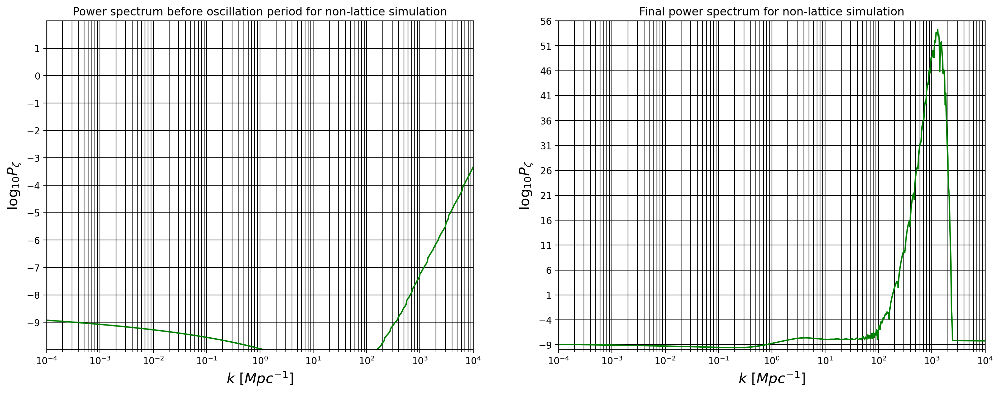

In [101]:
%matplotlib inline
%config InlineBackend.figure_formats = {'png', 'retina'}
import math
import numpy as np
import matplotlib.pyplot as plt

mode, PowerSpectrum_bfosc = np.loadtxt(parset_name + "/" + condition_name + "/spectrum_bfosc.txt", usecols = (2,4), unpack=True) # 2:k 4:log10PR 
mode, PowerSpectrum_final = np.loadtxt(parset_name + "/" + condition_name + "/spectrum_final.txt", usecols = (2,4), unpack=True) # 2:k 4:log10PR 
fig = plt.figure(figsize=(18, 14))# figsize=(width, height)
PSlabel = r"$ \log_{10}P_{\zeta}   $"
graphrow, graphcolumn = 2, 2

ax = fig.add_subplot(graphrow, graphcolumn, 1)
ax.plot(mode, PowerSpectrum_bfosc, "-", color="g", label=PSlabel) #r"$ \log_{10}P_{R}   $"
# ax.set_xlim(0, 1000)
ax.set_xlim(mode[0], mode[-1])
ax.set_ylim(-10, 2)
ax.set_xlabel("$k$ [$Mpc^{-1}$]", size = 15)
ax.set_ylabel(PSlabel, size = 15)
ax.set_yticks(np.arange(-9, 2, 1) )
ax.title.set_text('Power spectrum before oscillation period for non-lattice simulation')
plt.xscale('log')
plt.grid(which='major',color='black',linestyle='-')
plt.grid(which='minor',color='black',linestyle='-')

bx = fig.add_subplot(graphrow, graphcolumn, 2)
bx.plot(mode, PowerSpectrum_final, "-", color="g", label=PSlabel) #r"$ \log_{10}P_{R}   $"
# bx.set_xlim(0, 1000)
bx.set_xlim(mode[0], mode[-1])
bx.set_ylim(-10, 2)
bx.set_xlabel("$k$ [$Mpc^{-1}$]", size = 15)
bx.set_ylabel(PSlabel, size = 15)
bx.set_yticks(np.arange(-9, 60, 5) )
bx.title.set_text('Final power spectrum for non-lattice simulation')
plt.xscale('log')
plt.grid(which='major',color='black',linestyle='-')
plt.grid(which='minor',color='black',linestyle='-')
    
plt.show()

## 4. Mode functions of non-lattice simulation right before oscillation period starts 
---
 #### Calculated mode range for non-lattice simulation:
 - Minimum: kfrom_Mpc = $10^{-4}$ (knum = 0)
 - Max: kto_Mpc = $10^{4}$ (knum = 800)
 - Interval: kinterval_knum = 1

In [102]:
%matplotlib inline
%config InlineBackend.figure_formats = {'png', 'retina'}
import math
import numpy as np
import matplotlib.pyplot as plt
 
mode, PowerSpectrum, P_sigma, P_psi, P_phi, d_11_re, d_12_re, d_13_re, d_21_re, d_22_re, d_23_re, d_31_re, d_32_re, d_33_re, d_11_p_re, d_12_p_re, \
d_13_p_re, d_21_p_re, d_22_p_re, d_23_p_re, d_31_p_re, d_32_p_re, d_33_p_re, Phi_1_re, Phi_2_re, Phi_3_re, Phi_1_p_re, Phi_2_p_re, \
Phi_3_p_re, d_11_im, d_12_im, d_13_im, d_21_im, d_22_im, d_23_im, d_31_im, d_32_im, d_33_im, d_11_p_im, d_12_p_im, d_13_p_im,\
d_21_p_im, d_22_p_im, d_23_p_im, d_31_p_im, d_32_p_im, d_33_p_im, Phi_1_im, Phi_2_im, Phi_3_im, Phi_1_p_im, Phi_2_p_im, Phi_3_p_im\
= np.loadtxt(parset_name + "/" + condition_name + "/spectrum_bfosc.txt", usecols \
= (2,4,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56)\
, unpack=True) # 2:k 4:log10PR from 7 perturb 
fig = plt.figure(figsize=(36, 84))# figsize=(width, height)
graphrow, graphcolumn = 12, 4

# --------------------------
F_k_re = [d_11_re, d_12_re, d_13_re, d_21_re, d_22_re, d_23_re, d_31_re, d_32_re, d_33_re, Phi_1_re, Phi_2_re, Phi_3_re]
F_k_im = [d_11_im, d_12_im, d_13_im, d_21_im, d_22_im, d_23_im, d_31_im, d_32_im, d_33_im, Phi_1_im, Phi_2_im, Phi_3_im]
dF_k_re = [d_11_p_re, d_12_p_re, d_13_p_re, d_21_p_re, d_22_p_re, d_23_p_re, d_31_p_re, d_32_p_re, d_33_p_re, Phi_1_p_re, Phi_2_p_re, Phi_3_p_re] 
dF_k_im = [d_11_p_im, d_12_p_im, d_13_p_im, d_21_p_im, d_22_p_im, d_23_p_im, d_31_p_im, d_32_p_im, d_33_p_im, Phi_1_p_im, Phi_2_p_im, Phi_3_p_im]

fields = ['\psi_{11}', '\psi_{12}', '\psi_{13}', '\psi_{21}', '\psi_{22}', '\psi_{23}', '\psi_{31}', '\psi_{32}', '\psi_{33}', 'f_{1}', 'f_{2}', 'f_{3}']
for index, item in enumerate(fields):
#     print("index： " + str(index) + ", name： " + item)
    
    F_k_re_log10 =  np.log10(np.abs(F_k_re[index]))
    F_k_im_log10 = np.log10(np.abs(F_k_im[index]))
    dF_k_re_log10 =  np.log10(np.abs(dF_k_re[index]))
    dF_k_im_log10 = np.log10(np.abs(dF_k_im[index]))
    
    #      F_k_re_log10
    bx = fig.add_subplot(graphrow, graphcolumn, 4*index+1)
    colors1 = np.where(F_k_re[index] <  0,'r','g')
    bx.scatter(mode, F_k_re_log10,  color=colors1, label=r"$\log_{10}Re"+ str(item)+ "$") #r"$ \log_{10}F_k  $"
    # bx.set_xlim(0, 1000)
    bx.set_xlim(mode[0], mode[-1])
    bx.set_ylim(50, 100)
    bx.set_xlabel("$k$ [$Mpc^{-1}$]", size = 15)
    bx.set_ylabel(r"$\log_{10}Re"+ str(item)+ "$", size = 15)
    bx.set_yticks(np.arange(50, 100, 10) )
    # bx.legend(loc="right")

    plt.xscale('log')
    plt.grid(which='major',color='black',linestyle='-')
    plt.grid(which='minor',color='black',linestyle='-')

    #     F_k_im_log10
    cx = fig.add_subplot(graphrow, graphcolumn, 4*index+2)
    colors2 = np.where(F_k_im[index] <  0,'r','g')
    cx.scatter(mode, F_k_im_log10, color=colors2, label=r"$\log_{10}Im"+ str(item) + "$") #r"$ \log_{10}F_k_p  $"
    # cx.set_xlim(0, 1000)
    cx.set_xlim(mode[0], mode[-1])
    cx.set_ylim(50, 100)
    cx.set_xlabel("$k$ [$Mpc^{-1}$]", size = 15)
    cx.set_ylabel(r"$\log_{10}Im"+ str(item) + "$", size = 15)
    cx.set_yticks(np.arange(50, 100, 10) )
    # cx.legend(loc="right")

    plt.xscale('log')
    plt.grid(which='major',color='black',linestyle='-')
    plt.grid(which='minor',color='black',linestyle='-')

    #     dF_k_re_log10
    dx = fig.add_subplot(graphrow, graphcolumn, 4*index+3)
    colors3 = np.where(dF_k_re[index] <  0,'r','g')
    dx.scatter(mode,  dF_k_re_log10, color=colors3, label=r"$\log_{10}Re\dot"+ str(item)+ "$") 
    # dx.set_xlim(0, 1000)
    dx.set_xlim(mode[0], mode[-1])
    dx.set_ylim(50, 100)
    dx.set_xlabel("$k$ [$Mpc^{-1}$]", size = 15)
    dx.set_ylabel(r"$\log_{10}Re\dot"+ str(item)+ "$", size = 15)
    dx.set_yticks(np.arange(50, 100, 10) )
    # dx.legend(loc="right")

    plt.xscale('log')
    plt.grid(which='major',color='black',linestyle='-')
    plt.grid(which='minor',color='black',linestyle='-')
    
    #     dF_k_im_log10
    ex = fig.add_subplot(graphrow, graphcolumn, 4*index+4)
    colors4 = np.where(dF_k_im[index] <  0,'r','g')
    ex.scatter(mode,  dF_k_im_log10, color=colors4, label=r"$\log_{10}Im\dot"+ str(item)+ "$") 
    # ex.set_xlim(0, 1000)
    ex.set_xlim(mode[0], mode[-1])
    ex.set_ylim(50, 100)
    ex.set_xlabel("$k$ [$Mpc^{-1}$]", size = 15)
    ex.set_ylabel(r"$\log_{10}Im\dot"+ str(item)+ "$", size = 15)
    ex.set_yticks(np.arange(50, 100, 10) )
    # ex.legend(loc="right")

    plt.xscale('log')
    plt.grid(which='major',color='black',linestyle='-')
    plt.grid(which='minor',color='black',linestyle='-')

#plt.savefig("spectrum_bfosc.png", dpi=300)
plt.show()


## 5. Linear perturbation variables right before oscillation period starts
---
 #### Calculated mode range for non-lattice simulation:
 - Minimum: kfrom_Mpc = $10^{-4}$ (knum = 0)
 - Max: kto_Mpc = $10^{4}$ (knum = 800)
 - Interval: kinterval_knum = 1

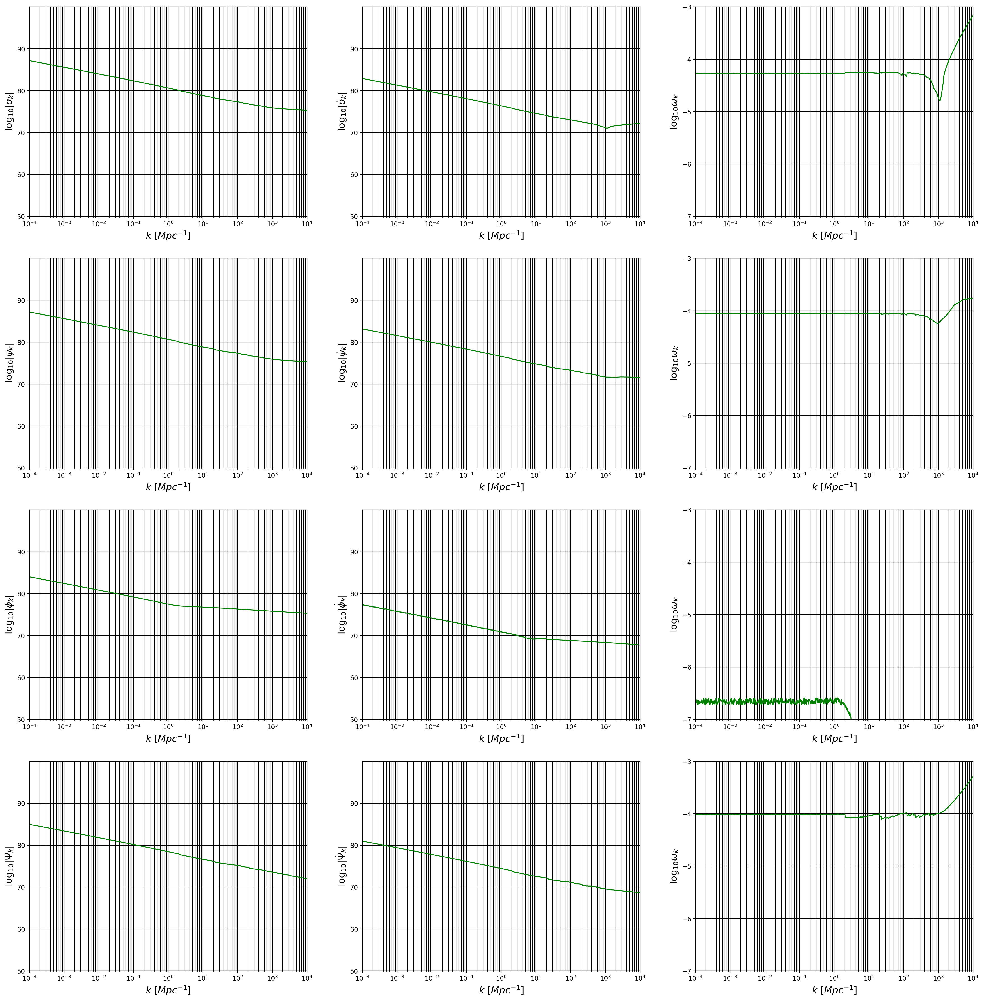

In [103]:
%matplotlib inline
%config InlineBackend.figure_formats = {'png', 'retina'}
import math
import numpy as np
import matplotlib.pyplot as plt
 
mode, PowerSpectrum, P_sigma, P_psi, P_phi, d_11_re, d_12_re, d_13_re, d_21_re, d_22_re, d_23_re, d_31_re, d_32_re, d_33_re, d_11_p_re, d_12_p_re, d_13_p_re,\
d_21_p_re, d_22_p_re, d_23_p_re, d_31_p_re, d_32_p_re, d_33_p_re, Phi_1_re, Phi_2_re, Phi_3_re, Phi_1_p_re, Phi_2_p_re, Phi_3_p_re, \
d_11_im, d_12_im, d_13_im, d_21_im, d_22_im, d_23_im, d_31_im, d_32_im, d_33_im, d_11_p_im, d_12_p_im, d_13_p_im, d_21_p_im, d_22_p_im, d_23_p_im,\
d_31_p_im, d_32_p_im, d_33_p_im, Phi_1_im, Phi_2_im, Phi_3_im, Phi_1_p_im, Phi_2_p_im, Phi_3_p_im \
= np.loadtxt(parset_name + "/" + condition_name + "/spectrum_bfosc.txt", usecols \
= (2,4,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56),\
unpack=True) # 2:k 4:log10PR from 7 perturb 
fig = plt.figure(figsize=(27, 35))# figsize=(width, height)
graphrow, graphcolumn = 5, 3

# --------------------------
F_k_re = [d_11_re, d_12_re, d_13_re, d_21_re, d_22_re, d_23_re, d_31_re, d_32_re, d_33_re, Phi_1_re, Phi_2_re, Phi_3_re]
F_k_im = [d_11_im, d_12_im, d_13_im, d_21_im, d_22_im, d_23_im, d_31_im, d_32_im, d_33_im, Phi_1_im, Phi_2_im, Phi_3_im]
dF_k_re = [d_11_p_re, d_12_p_re, d_13_p_re, d_21_p_re, d_22_p_re, d_23_p_re, d_31_p_re, d_32_p_re, d_33_p_re, Phi_1_p_re, Phi_2_p_re, Phi_3_p_re] 
dF_k_im = [d_11_p_im, d_12_p_im, d_13_p_im, d_21_p_im, d_22_p_im, d_23_p_im, d_31_p_im, d_32_p_im, d_33_p_im, Phi_1_p_im, Phi_2_p_im, Phi_3_p_im]

fields = ['\sigma_{k}', '\psi_{k}', '\phi_{k}', '\Psi_{k}']
for index, item in enumerate(fields):
#     print("index： " + str(index) + ", name： " + item)
    F_k_2_re = pow(F_k_re[3*index] , 2) + pow(F_k_re[3*index+1] , 2) + pow(F_k_re[3*index+2] , 2) 
    F_k_2_im =  pow(F_k_im[3*index] , 2) + pow(F_k_im[3*index+1] , 2) + pow(F_k_im[3*index+2] , 2) 
    F_k = pow(F_k_2_re + F_k_2_im, 0.5)
    F_k_log10 =  np.log10(F_k)
    
    F_k_2_p_re = pow(dF_k_re[3*index] , 2) + pow(dF_k_re[3*index] , 2) + pow(dF_k_re[3*index] , 2) 
    F_k_2_p_im = pow(dF_k_im[3*index] , 2) + pow(dF_k_im[3*index] , 2) + pow(dF_k_im[3*index] , 2) 
    F_k_p = pow(F_k_2_p_re + F_k_2_p_im, 0.5)
    F_k_p_log10 =  np.log10(F_k_p)
    
    #     F_k
    bx = fig.add_subplot(graphrow, graphcolumn, 3*index+4)
    bx.plot(mode, F_k_log10, "-", color="g", label=r"$ \log_{10}F_k   $") #r"$ \log_{10}F_k  $"
    # bx.set_xlim(0, 1000)
    bx.set_xlim(mode[0], mode[-1])
    bx.set_ylim(50, 100)
    bx.set_xlabel("$k$ [$Mpc^{-1}$]", size = 15)
    bx.set_ylabel(r"$\log_{10}|"+ str(item)+ "|$", size = 15)
    bx.set_yticks(np.arange(50, 100, 10) )
    # bx.legend(loc="right")

    plt.xscale('log')
    plt.grid(which='major',color='black',linestyle='-')
    plt.grid(which='minor',color='black',linestyle='-')

    #     dF_k/dt
    cx = fig.add_subplot(graphrow, graphcolumn, 3*index+5)
    cx.plot(mode, F_k_p_log10, "-", color="g", label=r"$ \log_{10}F_k_p   $") #r"$ \log_{10}F_k_p  $"
    # cx.set_xlim(0, 1000)
    cx.set_xlim(mode[0], mode[-1])
    cx.set_ylim(50, 100)
    cx.set_xlabel("$k$ [$Mpc^{-1}$]", size = 15)
    cx.set_ylabel(r"$\log_{10}|\dot"+ str(item) + "|$", size = 15)
    cx.set_yticks(np.arange(50, 100, 10) )
    # cx.legend(loc="right")

    plt.xscale('log')
    plt.grid(which='major',color='black',linestyle='-')
    plt.grid(which='minor',color='black',linestyle='-')

    omega = F_k_p/F_k
    omega_log10 = np.log10(omega)

    dx = fig.add_subplot(graphrow, graphcolumn, 3*index+6)
    dx.plot(mode, omega_log10, "-", color="g", label=r"$ \log_{10}\omega_{k}$"+ str(index)) 
    # dx.set_xlim(0, 1000)
    dx.set_xlim(mode[0], mode[-1])
    dx.set_ylim(-6, -4)
    dx.set_xlabel("$k$ [$Mpc^{-1}$]", size = 15)
    dx.set_ylabel(r"$ \log_{10}\omega_{k}$", size = 15)
    dx.set_yticks(np.arange(-7, -2, 1) )
    # dx.legend(loc="right")

    plt.xscale('log')
    plt.grid(which='major',color='black',linestyle='-')
    plt.grid(which='minor',color='black',linestyle='-')

#plt.savefig("spectrum_bfosc.png", dpi=300)
plt.show()


## 6. Lattice simulation and zero mode simulation results comparison
---
#### Calculated mode range and parameters for lattice simulation
  - Non-lattice range:
       - Minimum: kfrom_Mpc = $10^{-4}$ (knum = 0)
       - Max: kto_Mpc = $10^{4}$ (knum = 800)
       - Interval: kinterval_knum = 100
  - Lattice range:
       - Minimum: kfrom_Mpc_lattice = 3
       - Max: kto_Mpc_lattice = 400 
       - Grid Number: N = 64
       - Dimension: dim = 1

In [104]:
condition_lattice_name = "zs_true-ps_true-ls_true-kfrom_0.0001-kto_10000.0-iknum_50-kfroml_10-ktol_2560-N_512-dim_1"

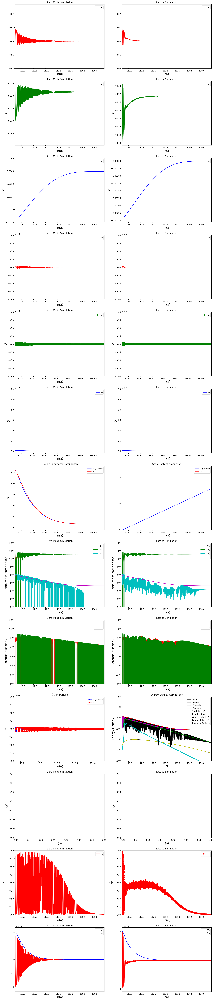

In [122]:
%matplotlib inline
%config InlineBackend.figure_formats = {'png', 'retina'}

# import matplotlib as mpl
import math
import numpy as np
import matplotlib.ticker
#matplotlib.use('Agg')
import matplotlib.pyplot as plt
# matplotlib.rcParams['agg.path.chunksize'] = 100000
# matplotlib.rcParams['agg.path.chunksize'] = 1000000000

#Zeromode  Parameters
_time, loga, sigma, psi, phi,sigma_dot, psi_dot, phi_dot, w, rho, kinetic, potential, _radiation,  _adotdot, epsilon,\
msigma, mpsi, mphi, _hubble, dVsigma, dVpsi, dVphi, pdivrho_z, kdiva_z, mode200, mode400, mode634,mode700 \
= np.loadtxt(parset_name + "/zs_true/zeromode.txt", unpack=True) # 0:t 1: loga, 2: sigma, 3: psi, 4: phi, 5:w 13:mode 


#Lattice Simulation  Parameters
time, scalefactor, efolds, f_average_sigma, f_average_psi, f_average_phi, f_average_metric, f_variance_sigma, f_variance_psi, \
f_variance_phi, f_variance_metric,  df_average_sigma, df_average_psi, df_average_phi, df_average_metric, df_variance_sigma, \
df_variance_psi, df_variance_phi, df_variance_metric,  total_average, total_energy_var, timederiv_average, grad_average, \
potential_average, radiation, pressure_average, hubble, adotdot,  energy_max, m_sigma, m_psi, m_phi, dV_sigma, dV_psi, dV_phi= \
np.loadtxt(parset_name + "/" + condition_lattice_name + "/lattice.txt", skiprows=1,  unpack=True)
#0: time  (pr), #1: scalefactor (pr), #2: efolds
#3:f_average_sigma  (reduced Plank units), #4:f_average_psi  (reduced Plank units), #5:f_average_phi (reduced Plank units), #6:f_average_metric  (reduced Plank units), 
#7:f_variance_sigma  (reduced Plank units), #8:f_variance_psi  (reduced Plank units), #9:f_variance_phi  (reduced Plank units), #10:f_variance_metric  (reduced Plank units),
#11:df_average_sigma  (pr), #12:df_average_psi  (pr), #13:df_average_phi (pr), #14:df_average_metric  (pr), 
#15:df_variance_sigma  (pr), #16:df_variance_psi  (pr), #17:df_variance_phi  (pr), #18:df_variance_metric  (pr),
#19:total_average (reduced Plank units), 20: total_variance(reduced Plank units),
#21:timederiv_average (reduced Plank units), 
#22: grad_average (reduced Plank units), 23: potential_average (reduced Plank units), 24: radiation (reduced Plank units)
#25: pressure_average (Plank units) 26: hubble (Plank units)
#27: adotdot() (Plank units) 28:energy_max

graphrow, graphcolumn =15, 2

fig = plt.figure(figsize=(graphcolumn*9, graphrow*7))# figsize=(width, height)

#Zeromode variables

#Lattice Simulation variables
xvariable = efolds
xlabel = "N"

#Field evolution of sigma for zero mode simulation
ax1 = fig.add_subplot(graphrow, graphcolumn, 1)
ax1.plot(loga, sigma, "-", color="r", label=r"$ \sigma  $")
# ax1.plot(loga, psi_dot, "-", color="g", label=r"$ \dot{\psi } $")
# ax1.plot(loga, phi_dot, "-", color="b", label=r"$ \dot{\phi}  $", marker='o')
# ax1.set_xlim(0, 10000)
ax1.set_xlim(xvariable[0], xvariable[-1])
ax1.set_ylim(-0.02, 0.027)
ax1.set_xlabel("ln(a)", size = 15)
ax1.set_ylabel(r"$ \sigma $", size = 15)
ax1.legend(loc="upper right")
ax1.title.set_text('Zero Mode Simulation')

#Field evolution of sigma for lattice simulation
bx1= fig.add_subplot(graphrow, graphcolumn, 2)
bx1.plot(xvariable, f_average_sigma, "-", color="r", label=r"$ \sigma  $")
# bx1.plot(loga, sigma, "-", color="b", label=r"$ \sigma  $", marker='o')
# bx1.plot(xvariable, df_average_psi, "-", color="g", label=r"$ \dot{\psi } $")
# bx1.plot(xvariable, df_average_phi, "-", color="b", label=r"$ \dot{\phi}  $", marker='o')
# bx1.set_xlim(0, 10000)
bx1.set_xlim(xvariable[0], xvariable[-1])
bx1.set_ylim(-0.02, 0.027)
bx1.set_xlabel("ln(a)", size = 15)
bx1.set_ylabel(r"$ \sigma $", size = 15)
bx1.legend(loc="upper right")
bx1.title.set_text('Lattice Simulation')

#Field evolution of psi for zero mode simulation
ax2 = fig.add_subplot(graphrow, graphcolumn, 3)
# ax2.plot(loga, sigma_dot, "-", color="r", label=r"$ \dot{\sigma}  $", marker='o')
ax2.plot(loga, psi, "-", color="g", label=r"$ \psi  $")
# ax2.plot(loga, phi_dot, "-", color="b", label=r"$ \dot{\phi}  $", marker='o')
# ax2.set_xlim(0, 10000)
ax2.set_xlim(xvariable[0], xvariable[-1])
# ax2.set_ylim(0.06, 0.11)
ax2.set_xlabel("ln(a)", size = 15)
ax2.set_ylabel(r"$\psi$ ", size = 15)
ax2.legend(loc="upper right")
ax2.title.set_text('Zero Mode Simulation')

#Field evolution of psi for lattice simulation
bx2 = fig.add_subplot(graphrow, graphcolumn, 4)
# bx2.plot(xvariable, df_average_sigma, "-", color="r", label=r"$ \dot{\sigma}  $", marker='o')
bx2.plot(xvariable, f_average_psi, "-", color="g", label=r"$ \psi  $")
# bx2.plot(xvariable, df_average_phi, "-", color="b", label=r"$ \dot{\phi}  $", marker='o')
# bx2.set_xlim(0, 10000)
bx2.set_xlim(xvariable[0], xvariable[-1])
# bx2.set_ylim(-pow(10,-5), pow(10,-5))
bx2.set_xlabel("ln(a)", size = 15)
bx2.set_ylabel(r"$ \psi   $", size = 15)
bx2.legend(loc="upper right")
bx2.title.set_text('Lattice Simulation')

#Field evolution of phi for zero mode simulation
ax3 = fig.add_subplot(graphrow, graphcolumn, 5)
# ax3.plot(loga, sigma_dot, "-", color="r", label=r"$ \dot{\sigma}  $", marker='o')
# ax3.plot(loga, psi_dot, "-", color="g", label=r"$ \dot{\psi } $")
ax3.plot(loga, phi, "-", color="b", label=r"$ \phi $")
# ax3.set_xlim(0, 10000)
ax3.set_xlim(xvariable[0], xvariable[-1])
ax3.set_ylim(-0.0025, 0)
ax3.set_xlabel("ln(a)", size = 15)
ax3.set_ylabel(r"$ \phi$", size = 15)
ax3.legend(loc="upper right")
ax3.title.set_text('Zero Mode Simulation')

#Field evolution of phi for lattice simulation
bx3= fig.add_subplot(graphrow, graphcolumn, 6)
# bx3.plot(xvariable, df_average_sigma, "-", color="r", label=r"$ \dot{\sigma}  $", marker='o')
# bx3.plot(xvariable, df_average_psi, "-", color="g", label=r"$ \dot{\psi } $")
bx3.plot(xvariable, f_average_phi, "-", color="b", label=r"$ \phi  $")
# bx3.set_xlim(0, 10000)
bx3.set_xlim(xvariable[0], xvariable[-1])
# bx3.set_ylim(0, 3*pow(10,-8))
bx3.set_xlabel("ln(a)", size = 15)
bx3.set_ylabel(r"$  \phi $", size = 15)
bx3.legend(loc="upper right")
bx3.title.set_text('Lattice Simulation')

#Field derivative evolution of dotsigma for zero mode simulation
ax4 = fig.add_subplot(graphrow, graphcolumn, 7)
ax4.plot(loga, sigma_dot, "-", color="r", label=r"$ \dot{\sigma}  $")
# ax4.plot(loga, psi_dot, "-", color="g", label=r"$ \dot{\psi } $")
# ax4.plot(loga, phi_dot, "-", color="b", label=r"$ \dot{\phi}  $", marker='o')
# ax4.set_xlim(0, 10000)
ax4.set_xlim(xvariable[0], xvariable[-1])
ax4.set_ylim(-pow(10,-5), pow(10,-5))
ax4.set_xlabel("ln(a)", size = 15)
ax4.set_ylabel(r"$\dot{\sigma}$", size = 15)
ax4.legend(loc="upper right")
ax4.title.set_text('Zero Mode Simulation')

#Field derivative evolution of dotsigma for lattice simulation
bx4 = fig.add_subplot(graphrow, graphcolumn, 8)
bx4.plot(xvariable, df_average_sigma, "-", color="r", label=r"$ \dot{\sigma}  $")
# bx4.plot(xvariable, df_average_psi, "-", color="g", label=r"$ \dot{\psi } $")
# bx4.plot(xvariable, df_average_phi, "-", color="b", label=r"$ \dot{\phi}  $", marker='o')
# bx4.set_xlim(0, 10000)
bx4.set_xlim(xvariable[0], xvariable[-1])
bx4.set_ylim(-pow(10,-5), pow(10,-5))
bx4.set_xlabel("ln(a)", size = 15)
bx4.set_ylabel(r"$  \dot{\sigma} $", size = 15)
bx4.legend(loc="upper right")
bx4.title.set_text('Lattice Simulation')

#Field derivative evolution of dotpsi for zero mode simulation
ax5 = fig.add_subplot(graphrow, graphcolumn, 9)
# ax5.plot(loga, sigma_dot, "-", color="r", label=r"$ \dot{\sigma}  $", marker='o')
ax5.plot(loga, psi_dot, "-", color="g", label=r"$ \dot{\psi } $", marker='o')
# ax5.plot(loga, phi_dot, "-", color="b", label=r"$ \dot{\phi}  $", marker='o')
# ax5.set_xlim(0, 10000)
ax5.set_xlim(xvariable[0], xvariable[-1])
ax5.set_ylim(-pow(10,-5), pow(10,-5))
ax5.set_xlabel("ln(a)", size = 15)
ax5.set_ylabel(r"$\dot{\psi }$", size = 15)
ax5.legend(loc="upper right")
ax5.title.set_text('Zero Mode Simulation')

#Field derivative evolution of dotpsi for lattice simulation
bx5 = fig.add_subplot(graphrow, graphcolumn, 10)
# bx5.plot(xvariable, df_average_sigma, "-", color="r", label=r"$ \dot{\sigma}  $", marker='o')
bx5.plot(xvariable, df_average_psi, "-", color="g", label=r"$ \dot{\psi } $", marker='o')
# bx5.plot(xvariable, df_average_phi, "-", color="b", label=r"$ \dot{\phi}  $", marker='o')
# bx5.set_xlim(0, 10000)
bx5.set_xlim(xvariable[0], xvariable[-1])
bx5.set_ylim(-pow(10,-5), pow(10,-5))
bx5.set_xlabel("ln(a)", size = 15)
bx5.set_ylabel(r"$ \dot{\psi }$", size = 15)
bx5.legend(loc="upper right")
bx5.title.set_text('Lattice Simulation')

#Field derivative evolution of dotphi for zero mode simulation
ax6 = fig.add_subplot(graphrow, graphcolumn, 11)
# ax6.plot(loga, sigma_dot, "-", color="r", label=r"$ \dot{\sigma}  $", marker='o')
# ax6.plot(loga, psi_dot, "-", color="g", label=r"$ \dot{\psi } $")
ax6.plot(loga, phi_dot, "-", color="b", label=r"$ \dot{\phi}  $")
# ax6.set_xlim(0, 10000)
ax6.set_xlim(xvariable[0], xvariable[-1])
ax6.set_ylim(-pow(10,-9), 3*pow(10,-8))
ax6.set_xlabel("ln(a)", size = 15)
ax6.set_ylabel(r"$\dot{\phi}$", size = 15)
ax6.legend(loc="upper right")
ax6.title.set_text('Zero Mode Simulation')

#Field derivative evolution of dotphi for lattice simulation
bx6 = fig.add_subplot(graphrow, graphcolumn, 12)
# bx6.plot(xvariable, df_average_sigma, "-", color="r", label=r"$ \dot{\sigma}  $", marker='o')
# bx6.plot(xvariable, df_average_psi, "-", color="g", label=r"$ \dot{\psi } $")
bx6.plot(xvariable, df_average_phi, "-", color="b", label=r"$ \dot{\phi}  $")
# bx6.set_xlim(0, 10000)
bx6.set_xlim(xvariable[0], xvariable[-1])
bx6.set_ylim(-pow(10,-9), 3*pow(10,-8))
bx6.set_xlabel("ln(a)", size = 15)
bx6.set_ylabel(r"$ \dot{\phi} $", size = 15)
bx6.legend(loc="upper right")
bx6.title.set_text('Lattice Simulation')

#Hubble parameter comparison
ax7= fig.add_subplot(graphrow, graphcolumn, 13)
# ax7.plot(xvariable, df_average_sigma, "-", color="r", label=r"$ \dot{\sigma}  $", marker='o')
# ax7.plot(xvariable, df_average_psi, "-", color="g", label=r"$ \dot{\psi } $")
ax7.plot(xvariable, hubble, "-", color="b", label=r"$H \ (lattice) $")
ax7.plot(loga, _hubble, "-", color="r", label=r"$H$")
# ax7.set_xlim(0, 10000)
ax7.set_xlim(xvariable[0], xvariable[-1])
# ax7.set_ylim(0, 3*pow(10,-8))
ax7.set_xlabel("ln(a)", size = 15)
ax7.set_ylabel(r"$  H$", size = 15)
#ax7.set_yticks(np.arange(1.42672*math.sqrt(2)-0.05,1.42672*math.sqrt(2)+ 0.10,0.01) )
ax7.legend(loc="upper right")
ax7.title.set_text('Hubble Parameter Comparison')


#Scale factor comparison
sf_zeromode = np.exp(loga)
bx7 = fig.add_subplot(graphrow, graphcolumn, 14)
# bx7.plot(loga, sigma_dot, "-", color="r", label=r"$ \dot{\sigma}  $", marker='o')
# bx7.plot(loga, psi_dot, "-", color="g", label=r"$ \dot{\psi } $")
bx7.plot(xvariable, scalefactor, "-", color="b", label=r"$a \ (lattice) $")
bx7.plot(loga, sf_zeromode , "-", color="r", label=r"$a$")
# bx7.set_xlim(0, 10000)
bx7.set_xlim(xvariable[0], xvariable[-1])
bx7.set_ylim(1, 300)
bx7.set_xlabel("ln(a)", size = 15)
bx7.set_ylabel(r"", size = 15)
bx7.set_yscale("log")
#bx7.set_yticks(np.arange(1.42672*math.sqrt(2)-0.05,1.42672*math.sqrt(2)+ 0.10,0.01) )
bx7.legend(loc="upper right")
bx7.title.set_text('Scale Factor Comparison')

#Hubble-mass comparison for zero mode simulation
m_phi_abs = np.abs(m_phi)
ax8 = fig.add_subplot(graphrow, graphcolumn, 15)
# ax8.plot(scalefactor, 3*hubble*hubble, "-", color="b",label=r' $3H^{2}$')
ax8.plot(loga, msigma , "-", color="r",label=r' $m_{\sigma}^{2}$')
ax8.plot(loga, mpsi , "-", color="g",label=r' $m_{\psi}^{2}$')
ax8.plot(loga, mphi, "-", color="c",label=r' $m_{\phi}^{2}$')
ax8.plot(loga, _hubble*_hubble, "-", color="m",label=r' $H^{2}$')
ax8.legend(loc="upper right")
ax8.set_xlim(xvariable[0], xvariable[-1])
ax8.set_ylim(pow(10,-21), pow(10,-5))
ax8.set_yscale("log")
ax8.set_xlabel("$ln(a)$", size = 15)
ax8.set_ylabel("Hubble-mass comparison", size = 15)
ax8.title.set_text('Zero Mode Simulation')

#Hubble-mass comparison for lattice simulation
bx8 = fig.add_subplot(graphrow, graphcolumn, 16)
# bx8.plot(scalefactor, 3*hubble*hubble, "-", color="b",label=r' $3H^{2}$')
bx8.plot(xvariable, m_sigma , "-", color="r",label=r' $m_{\sigma}^{2}$')
bx8.plot(xvariable, m_psi , "-", color="g",label=r' $m_{\psi}^{2}$')
bx8.plot(xvariable, m_phi_abs, "-", color="c",label=r' $m_{\phi}^{2}$')
bx8.plot(xvariable, hubble*hubble, "-", color="m",label=r' $H^{2}$')
bx8.legend(loc="upper right")
bx8.set_xlim(xvariable[0], xvariable[-1])
bx8.set_ylim(pow(10,-21), pow(10,-5))
bx8.set_yscale("log")
bx8.set_xlabel("$ln(a)$", size = 15)
bx8.set_ylabel("Hubble-mass comparison", size = 15)
bx8.title.set_text('Lattice Simulation')

#Potential fist deriv comparison for zero mode simulation
ax9 = fig.add_subplot(graphrow, graphcolumn, 17)
# ax9.plot(scalefactor, 3*hubble*hubble, "-", color="b",label=r' $3H^{2}$')
ax9.plot(loga, dVsigma , "-", color="r",label=r' $\frac{\partial V}{\partial \sigma}$')
ax9.plot(loga, dVpsi , "-", color="g",label=r' $\frac{\partial V}{\partial \psi}$')
#ax9.plot(loga, abs(dVphi), "-", color="c",label=r' $\frac{\partial V}{\partial \phi}$')
ax9.legend(loc="upper right")
ax9.set_xlim(xvariable[0], xvariable[-1])
ax9.set_ylim(pow(10,-21), pow(10,-7))
ax9.set_yscale("log")
ax9.set_xlabel("$ln(a)$", size = 15)
ax9.set_ylabel("Potential fist deriv", size = 15)
ax9.title.set_text('Zero Mode Simulation')

#Potential fist deriv comparison for lattice simulation
bx9 = fig.add_subplot(graphrow, graphcolumn, 18)
# bx9.plot(scalefactor, 3*hubble*hubble, "-", color="b",label=r' $3H^{2}$')
bx9.plot(xvariable, dV_sigma , "-", color="r",label=r' $\frac{\partial V}{\partial \sigma}$')
bx9.plot(xvariable, dV_psi , "-", color="g",label=r' $\frac{\partial V}{\partial \psi}$')
#bx9.plot(xvariable, abs(dV_phi), "-", color="c",label=r' $\frac{\partial V}{\partial \phi}$')
bx9.legend(loc="upper right")
bx9.set_xlim(xvariable[0], xvariable[-1])
bx9.set_ylim(pow(10,-21), pow(10,-7))
bx9.set_yscale("log")
bx9.set_xlabel("$ln(a)$", size = 15)
bx9.set_ylabel("Potential fist deriv", size = 15)
bx9.title.set_text('Lattice Simulation')

#adotdot comparison
ax10= fig.add_subplot(graphrow, graphcolumn, 19)
ax10.plot(xvariable, adotdot, "-", color="b", label=r"$\ddot{a}$ (lattice)", marker='o')
ax10.plot(loga, _adotdot, "-", color="r", label=r"$\ddot{a}$", marker='o')
# ax10.set_xlim(0, 10000)
ax10.set_xlim(xvariable[0], xvariable[0]+1)
ax10.set_ylim(-pow(10,-61), pow(10,-61))
ax10.set_xlabel("ln(a)", size = 15)
ax10.set_ylabel(r"$  \ddot{a}$", size = 15)
#ax10.set_yticks(np.arange(1.42672*math.sqrt(2)-0.05,1.42672*math.sqrt(2)+ 0.10,0.01) )
ax10.legend(loc="upper right")
ax10.title.set_text(r"$  \ddot{a}$ Comparison")

#Energy density comparison
bx10 = fig.add_subplot(graphrow, graphcolumn,20)
bx10.plot(loga, rho , "-", color="k",label=r' Total')
# bx10.plot(scalefactor, 3*hubble*hubble, "-", color="b",label=r' $3H^{2}$')
bx10.plot(loga, kinetic , "-", color="k",label=r' Kinetic')
bx10.plot(loga, potential , "-", color="k",label=r' Potential')
bx10.plot(loga, _radiation, "-", color="k",label=r' Radiation')
bx10.plot(xvariable, total_average , "-", color="r",label=r'Total (lattice)')
# bx10.plot(scalefactor, 3*hubble*hubble, "-", color="b",label=r' $3H^{2}$')
bx10.plot(xvariable, timederiv_average , "-", color="g",label=r'Kinetic lattice')
bx10.plot(xvariable, grad_average , "-", color="c",label=r'Gradient (lattice)')
bx10.plot(xvariable, potential_average , "-", color="m",label=r'Potential (lattice)')
bx10.plot(xvariable, radiation , "-", color="y",label=r'Radiation (lattice)')
bx10.legend(loc="upper right")
bx10.set_xlim(xvariable[0], xvariable[-1])
bx10.set_ylim(pow(10,-21), pow(10,-9))
bx10.legend(loc="upper right")
bx10.set_yscale("log")
bx10.set_xlabel(xlabel, size = 15)
bx10.set_ylabel("Energy Density", size = 15)
bx10.title.set_text("Energy Density Comparison")

ax11 = fig.add_subplot(graphrow, graphcolumn, 21)
ax11.plot( sigma,  psi, "-", color="r",label=' ')
# plt.axhline(y=2.066968-2.0224, color='k', linestyle='-')
# ax11.set_xlim(f_average_sigma[-1], f_average_sigma[0])
# ax11.set_ylim( f_average_psi[-1], f_average_psi[0])
ax11.set_xlim(-0.02, 0.05)
ax11.set_ylim(0.08, 0.15)
ax11.set_xlabel(r"$  \langle \sigma\rangle $", size = 15)
ax11.set_ylabel(r"$  \langle \psi\rangle $", size = 15)
#ax11.set_ylabel(r"$  \langle \phi \rangle - \phi_{\rm min}$", size = 15)
#ax11.set_yticks(np.arange(1.42672*math.sqrt(2)-0.05,1.42672*math.sqrt(2)+ 0.10,0.01) )
#ax11.legend(loc="upper right")
ax11.title.set_text('Zero Mode Simulation')


bx11 = fig.add_subplot(graphrow, graphcolumn, 22)
bx11.plot( f_average_sigma,  f_average_psi, "-", color="r",label=' ')
# plt.axhline(y=2.066968-2.0224, color='k', linestyle='-')
# bx11.set_xlim(f_average_sigma[-1], f_average_sigma[0])
# bx11.set_ylim( f_average_psi[-1], f_average_psi[0])
bx11.set_xlim(-0.02, 0.05)
bx11.set_ylim(0.08, 0.15)
bx11.set_xlabel(r"$  \langle \sigma\rangle $", size = 15)
bx11.set_ylabel(r"$  \langle \psi\rangle $", size = 15)
#bx11.set_ylabel(r"$  \langle \phi \rangle - \phi_{\rm min}$", size = 15)
#bx11.set_yticks(np.arange(1.42672*math.sqrt(2)-0.05,1.42672*math.sqrt(2)+ 0.10,0.01) )
#bx11.legend(loc="upper right")
bx11.title.set_text('Lattice Simulation')

ax12 = fig.add_subplot(graphrow, graphcolumn, 23)
ax12.plot(loga, pdivrho_z , "-", color="r", label=r"$ \frac{P}{\rho} $")
ax12.set_xlim(xvariable[0], xvariable[-1])
ax12.set_ylim(-1, 1)
ax12.set_xlabel("ln(a)", size = 15)
ax12.set_ylabel(r"$ \frac{P}{\rho} $", size = 15)
ax12.legend(loc="upper right")
ax12.title.set_text('Zero Mode Simulation')

pdivrho_lattice = pressure_average/total_average

bx12= fig.add_subplot(graphrow, graphcolumn, 24)
bx12.plot(xvariable, pdivrho_lattice, "-", color="r", label=r"$ \frac{\langle P \rangle}{\langle \rho \rangle} $ ", marker='o')
bx12.set_xlim(xvariable[0], xvariable[-1])
bx12.set_ylim(-1, 1)
bx12.set_xlabel("ln(a)", size = 15)
bx12.set_ylabel(r"$ \frac{\langle P \rangle}{\langle \rho \rangle} $", size = 15)
bx12.legend(loc="upper right")
bx12.title.set_text('Lattice Simulation')

pressure_z = pdivrho_z*rho

ax13 = fig.add_subplot(graphrow, graphcolumn, 25)
ax13.plot(loga, pressure_z , "-", color="r", label=r"$ P $")
ax13.plot(loga, rho , "-", color="b", label=r"$ \rho $")
ax13.set_xlim(xvariable[0], xvariable[-1])
# ax13.set_ylim(-1, 1)
ax13.set_xlabel("ln(a)", size = 15)
# ax13.set_ylabel("", size = 15)
ax13.legend(loc="upper right")
ax13.title.set_text('Zero Mode Simulation')

bx13= fig.add_subplot(graphrow, graphcolumn, 26)
bx13.plot(xvariable, pressure_average , "-", color="r", label=r"$\langle  P \rangle$")
bx13.plot(xvariable, total_average , "-", color="b", label=r"$ \langle \rho \rangle$")
bx13.set_xlim(xvariable[0], xvariable[-1])
# bx13.set_ylim(-1, 1)
bx13.set_xlabel("ln(a)", size = 15)
# bx13.set_ylabel("", size = 15)
bx13.legend(loc="upper right")
bx13.title.set_text('Lattice Simulation')

plt.show()

## 7. Additional plots of variables in lattice simulation 
---
#### Calculated mode range and parameters for lattice simulation
  - Non-lattice range:
       - Minimum: kfrom_Mpc = $10^{-4}$ (knum = 0)
       - Max: kto_Mpc = $10^{4}$ (knum = 800)
       - Interval: kinterval_knum = 100
  - Lattice range:
       - Minimum: kfrom_Mpc_lattice = 3
       - Max: kto_Mpc_lattice = 400 
       - Grid Number: N = 64
       - Dimension: dim = 1

In [108]:

OSCEND = -1.09559e+02

kMpc_int = 110000

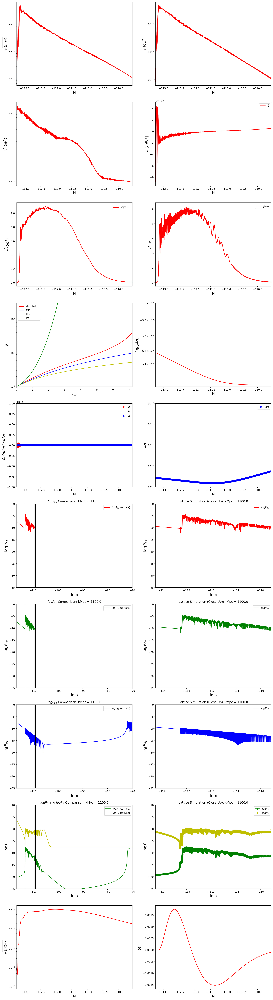

In [117]:
%matplotlib inline
%config InlineBackend.figure_formats = {'png', 'retina'}

# import matplotlib as mpl
import math
import numpy as np
import matplotlib.ticker
#matplotlib.use('Agg')
import matplotlib.pyplot as plt

#Lattice Simulation  Parameters (lattice.txt)
time, scalefactor, efolds, f_average_sigma, f_average_psi, f_average_phi, f_average_metric, f_variance_sigma, f_variance_psi, \
f_variance_phi, f_variance_metric,  df_average_sigma, df_average_psi, df_average_phi, df_average_metric, df_variance_sigma, \
df_variance_psi, df_variance_phi, df_variance_metric,  total_average, total_energy_var, timederiv_average, grad_average, \
potential_average, radiation, pressure_average, hubble, adotdot,  energy_max, m_sigma, m_psi, m_phi, dV_sigma, dV_psi, dV_phi= \
np.loadtxt(parset_name + "/" + condition_lattice_name + "/lattice.txt", skiprows=1,  unpack=True)
#0: time  (pr), #1: scalefactor (pr), #2: efolds
#3:f_average_sigma  (reduced Plank units), #4:f_average_psi  (reduced Plank units), #5:f_average_phi (reduced Plank units), #6:f_average_metric  (reduced Plank units), 
#7:f_variance_sigma  (reduced Plank units), #8:f_variance_psi  (reduced Plank units), #9:f_variance_phi  (reduced Plank units), #10:f_variance_metric  (reduced Plank units),
#11:df_average_sigma  (pr), #12:df_average_psi  (pr), #13:df_average_phi (pr), #14:df_average_metric  (pr), 
#15:df_variance_sigma  (pr), #16:df_variance_psi  (pr), #17:df_variance_phi  (pr), #18:df_variance_metric  (pr),
#19:total_average (reduced Plank units), 20: total_variance(reduced Plank units),
#21:timederiv_average (reduced Plank units), 
#22: grad_average (reduced Plank units), 23: potential_average (reduced Plank units), 24: radiation (reduced Plank units) 25: hubble (Plank units)
#26: adotdot() (Plank units) 27:energy_max

# 35000 #352
kMpc =  kMpc_int/100

#Lattice simulation (k-analyze_lattice)
loga_lattice, w_lattice, Pzeta_lattice, Pzeta_kspace_lattice, PPot_lattice, log10_rhopdivrho_lattice, log10_Hdiva_lattice, log10_kdivaH_lattice, \
Psigma_lattice, Ppsi_lattice, Pphi_lattice, log10_dsigma_lattice, log10_dpsi_lattice, log10_dphi_lattice, \
zeta0_portion_lattice, zeta1_portion_lattice, zeta2_portion_lattice, zeta3_portion_lattice, zeta4_portion_lattice, zeta5_portion_lattice, \
sigma_lattice, psi_lattice, phi_lattice, sigma_dot_lattice, psi_dot_lattice, phi_dot_lattice, \
rho_lattice, Kinetic_lattice, Potential_lattice, rho_rad_lattice, dda_lattice, epsilon_lattice,\
d_11_re_lattice, d_12_re_lattice, d_13_re_lattice, d_21_re_lattice, d_22_re_lattice, d_23_re_lattice, d_31_re_lattice, d_32_re_lattice, d_33_re_lattice,\
d_11_p_re_lattice, d_12_p_re_lattice, d_13_p_re_lattice, d_21_p_re_lattice, d_22_p_re_lattice, d_23_p_re_lattice, d_31_p_re_lattice, d_32_p_re_lattice,\
d_33_p_re_lattice, Phi_1_re_lattice, Phi_2_re_lattice, Phi_3_re_lattice, Phi_1_p_re_lattice, Phi_2_p_re_lattice, Phi_3_p_re_lattice, \
d_11_im_lattice, d_12_im_lattice, d_13_im_lattice, d_21_im_lattice, d_22_im_lattice, d_23_im_lattice, d_31_im_lattice, d_32_im_lattice, d_33_im_lattice,\
d_11_p_im_lattice, d_12_p_im_lattice, d_13_p_im_lattice, d_21_p_im_lattice, d_22_p_im_lattice, d_23_p_im_lattice,\
d_31_p_im_lattice, d_32_p_im_lattice, d_33_p_im_lattice, Phi_1_im_lattice, Phi_2_im_lattice, Phi_3_im_lattice, Phi_1_p_im_lattice, Phi_2_p_im_lattice, Phi_3_p_im_lattice \
= np.loadtxt(parset_name + "/" + condition_lattice_name +"/k-analyze_lattice/kMpc_"\
+ str(kMpc_int) + ".txt", unpack=True)

graphrow, graphcolumn = 10, 2

fig = plt.figure(figsize=(graphcolumn*9, graphrow*7))# figsize=(width, height)



#Lattice Simulation variables
xvariable = efolds
xlabel = "N"
xnumber = -1

ax1 = fig.add_subplot(graphrow, graphcolumn, 1)
ax1.plot(xvariable,  f_variance_sigma, "-", color="r", label="")
ax1.set_xlim(xvariable[0], xvariable[xnumber])
ax1.set_yscale("log")
#ax1.get_yaxis().set_major_formatter(matplotlib.ticker.LogFormatter( ))
#ax1.ticklabel_format(axis = 'y', style = 'sci', scilimits = (-5,-4))
#ax1.set_yticks([pow(10,-5),5*pow(10,-5), pow(10,-4),5*pow(10,-4),pow(10,-3)]) #np.arange(pow(10,-5),  2*pow(10,-4),9*pow(10,-5)) 
#ax1.set_yticklabels(["$10^{-5}$",r"$5\times10^{-5}$", " $10^{-4}$", r"$5 \times10^{-4}$"," $10^{-3}$"])
#ax1.set_ylim(pow(10,-5),  2*pow(10,-4))
ax1.set_xlabel(xlabel, size = 15)
ax1.set_ylabel(r"$ \sqrt{ \langle\delta\sigma^{2} \rangle } $", size = 15)
#ax1.legend(loc="lower right")

bx1 = fig.add_subplot(graphrow, graphcolumn, 2)
bx1.plot(xvariable,  f_variance_psi, "-", color="r", label="")
bx1.set_xlim(xvariable[0], xvariable[xnumber])
bx1.set_yscale("log")
#bx1.get_yaxis().set_major_formatter(matplotlib.ticker.LogFormatter( ))
#bx1.ticklabel_format(axis = 'y', style = 'sci', scilimits = (-5,-4))
#bx1.set_yticks([pow(10,-5),5*pow(10,-5), pow(10,-4),5*pow(10,-4),pow(10,-3)]) #np.arange(pow(10,-5),  2*pow(10,-4),9*pow(10,-5)) 
#bx1.set_yticklabels(["$10^{-5}$",r"$5\times10^{-5}$", " $10^{-4}$", r"$5 \times10^{-4}$"," $10^{-3}$"])
#bx1.set_ylim(pow(10,-5),  2*pow(10,-4))
bx1.set_xlabel(xlabel, size = 15)
bx1.set_ylabel(r"$ \sqrt{ \langle \delta \psi^{2} \rangle } $", size = 15)
#bx1.legend(loc="lower right")

ax2 = fig.add_subplot(graphrow, graphcolumn, 3)
ax2.plot(xvariable,  f_variance_phi, "-", color="r", label="")
ax2.set_xlim(xvariable[0], xvariable[xnumber])
ax2.set_yscale("log")
#ax2.get_yaxis().set_major_formatter(matplotlib.ticker.LogFormatter( ))
#ax2.ticklabel_format(axis = 'y', style = 'sci', scilimits = (-5,-4))
#ax2.set_yticks([pow(10,-5),5*pow(10,-5), pow(10,-4),5*pow(10,-4),pow(10,-3)]) #np.arange(pow(10,-5),  2*pow(10,-4),9*pow(10,-5)) 
#ax2.set_yticklabels(["$10^{-5}$",r"$5\times10^{-5}$", " $10^{-4}$", r"$5 \times10^{-4}$"," $10^{-3}$"])
#ax2.set_ylim(pow(10,-5),  2*pow(10,-4))
ax2.set_xlabel(xlabel, size = 15)
ax2.set_ylabel(r"$ \sqrt{ \langle\delta\phi^{2} \rangle } $", size = 15)
#ax2.legend(loc="lower right")

bx2 = fig.add_subplot(graphrow, graphcolumn,4)
bx2.plot(xvariable, adotdot , "-", color="r",label=r'$ \ddot{a}$')
bx2.legend(loc="upper right")
bx2.set_xlim(xvariable[0], xvariable[xnumber])
bx2.set_xlabel(xlabel, size = 15)
bx2.set_ylabel(r'$ \ddot{a} \  [mPl^{2}]$', size = 15)

cx=fig.add_subplot(graphrow, graphcolumn,5)
cx.plot(xvariable, total_energy_var, "-", color="r",label=r'$ \sqrt{ \langle\delta\rho^{2} \rangle }$')
cx.legend(loc="upper right")
cx.set_xlim(xvariable[0], xvariable[xnumber])
cx.set_xlabel(xlabel, size = 15)
cx.set_ylabel(r'$ \sqrt{ \langle\delta\rho^{2} \rangle }$', size = 15)

cx2=fig.add_subplot(graphrow, graphcolumn,6)
cx2.plot(xvariable, energy_max, "-", color="r",label=r'$ \rho_{max}$')
cx2.legend(loc="upper right")
cx2.set_xlim(xvariable[0], xvariable[xnumber])
cx2.set_xlabel(xlabel, size = 15)
cx2.set_ylabel(r'$  \rho_{max} $', size = 15)

Hpr = 0.596305
Nefold =[Hpr *a* tau for (a, tau) in zip(scalefactor, time)]
sf_md = [pow(Hpr*n/2+ 1,2)  for n in time]
sf_rad = [Hpr*n+ 1  for n in time]
sf_inf =  np.exp(Nefold) 
dx=fig.add_subplot(graphrow, graphcolumn, 7)
dx.plot(time, scalefactor, "-", color="r",label='simulation')
# dx.legend(loc="upper right")
dx.plot(time, sf_md, "-", color="b",label='MD')
dx.plot(time, sf_rad, "-", color="y",label='RD')
dx.plot(time, sf_inf, "-", color="g",label='Inf')
dx.set_xlim(time[0], time[-1])
dx.set_ylim(1, 300)
# dx.set_xlim(xvariable[0], xvariable[-1])
dx.set_xlabel(r'$ t_{pr}$', size = 15)
dx.set_ylabel(r'$ \bar{a}$', size = 15)
dx.set_yscale("log")
dx.legend(loc="upper left")

w =  np.log10(hubble)

dx2=fig.add_subplot(graphrow, graphcolumn, 8)
dx2.plot(xvariable, w , "-", color="r",label='')
# dx2.legend(loc="upper right")
dx2.set_xlim(xvariable[0], xvariable[xnumber])
# dx2.set_ylim(w[-1],w[0])
dx2.set_yscale("symlog")
dx2.set_xlabel(xlabel, size = 15)
dx2.set_ylabel(r'$ log_{10}(H)  $', size = 15)
dx2.set_yticks([-7,-6.5,-6,-5.5,-5])

ex = fig.add_subplot(graphrow, graphcolumn, 9)
ex.plot(xvariable, df_average_sigma, "-", color="r", label=r"$ \dot{\sigma}  $", marker='o')
ex.plot(xvariable, df_average_psi, "-", color="g", label=r"$ \dot{\psi } $")
ex.plot(xvariable, df_average_phi, "-", color="b", label=r"$ \dot{\phi}  $", marker='o')
# ex.set_xlim(0, 10000)
ex.set_xlim(xvariable[0], xvariable[xnumber])
ex.set_ylim(-pow(10,-5), pow(10,-5))
ex.set_xlabel(xlabel, size = 15)
ex.set_ylabel(r"$ field derivatives $", size = 15)
#ex.set_yticks(np.arange(1.42672*math.sqrt(2)-0.05,1.42672*math.sqrt(2)+ 0.10,0.01) )
ex.legend(loc="upper right")

aH = [x * y for (x, y) in zip(scalefactor, hubble)] 

ex2 = fig.add_subplot(graphrow, graphcolumn, 10)
ex2.plot(xvariable, aH, "-", color="b", label=r"$ aH  $", marker='o')
# ex2.set_xlim(0, 10000)
ex2.set_xlim(xvariable[0], xvariable[xnumber])
ex2.set_ylim(pow(10,-7), pow(10,-3))
ex2.set_xlabel(xlabel, size = 15)
ex2.set_ylabel(r"$ aH $", size = 15)
ex2.set_yscale("log")
#ex2.set_yticks(np.arange(1.42672*math.sqrt(2)-0.05,1.42672*math.sqrt(2)+ 0.10,0.01) )
ex2.legend(loc="upper right")

#power spectrums

fx1 = fig.add_subplot(graphrow, graphcolumn,11)
fx1.plot(loga_lattice, Psigma_lattice, "-", color="r", label=r"$ log P_{\delta\sigma} \ (lattice)   $")
fx1.axvline(x=OSCSTART, color='k')
fx1.axvline(x=OSCEND, color='k')
fx1.axvline(x=UNPERT, color='k')
# fx1.set_xlim(0, 1000)
fx1.set_xlim(loga_lattice[0], loga_lattice[-1])
fx1.set_ylim(-35,0)
fx1.set_xlabel("ln a", size = 15)
fx1.set_ylabel(r"$ \log P_{\delta\sigma} $", size = 15)
fx1.legend(loc="upper right")
fx1.title.set_text(r'$log P_{\delta\sigma}$ Comparison: kMpc = '+ str(kMpc))

fx2 = fig.add_subplot(graphrow, graphcolumn,12)
fx2.plot(loga_lattice, Psigma_lattice, "-", color="r", label=r"$ log P_{\delta\sigma}   $")
fx2.axvline(x=OSCSTART, color='k')
fx2.set_xlim(xvariable[0]-1, xvariable[xnumber])
fx2.set_ylim(-35,0)
fx2.set_xlabel("ln a", size = 15)
fx2.set_ylabel(r"$ \log P_{\delta\sigma} $", size = 15)
fx2.legend(loc="upper right")
fx2.title.set_text('Lattice Simulation (Close Up): kMpc = '+ str(kMpc))

gx1 = fig.add_subplot(graphrow, graphcolumn,13)
gx1.plot(loga_lattice, Ppsi_lattice, "-", color="g", label=r"$  log P_{\delta\psi} \ (lattice)   $")
gx1.axvline(x=OSCSTART, color='k')
gx1.axvline(x=OSCEND, color='k')
gx1.axvline(x=UNPERT, color='k')
# gx1.set_xlim(0, 1000)
gx1.set_xlim(loga_lattice[0], loga_lattice[-1])
gx1.set_ylim(-35,0)
gx1.set_xlabel("ln a", size = 15)
gx1.set_ylabel(r"$ \log P_{\delta\psi} $", size = 15)
gx1.legend(loc="upper right")
gx1.title.set_text(r'$log P_{\delta\psi}$ Comparison: kMpc = '+ str(kMpc))

gx2 = fig.add_subplot(graphrow, graphcolumn,14)
# gx2.plot(loga_lattice, Psigma_lattice, "-", color="r", label=r"$ log P_{\delta\sigma}  $")
gx2.plot(loga_lattice, Ppsi_lattice, "-", color="g", label=r"$  log P_{\delta\psi}  $")
# gx2.plot(loga_lattice, Pphi_lattice, "-", color="b", label=r"$  log P_{\delta\phi}  $")
gx2.axvline(x=OSCSTART, color='k')
# gx2.set_xlim(0, 1000)
gx2.set_xlim(xvariable[0]-1, xvariable[xnumber])
gx2.set_ylim(-35,0)
gx2.set_xlabel("ln a", size = 15)
gx2.set_ylabel(r"$ \log P_{\delta\psi} $", size = 15)
gx2.legend(loc="upper right")
gx2.title.set_text('Lattice Simulation (Close Up): kMpc = '+ str(kMpc))

hx = fig.add_subplot(graphrow, graphcolumn,15)
# hx.plot(loga, Psigma, "-", color="r", label=r"$ log P_{\delta\sigma}  $")
# hx.plot(loga, Ppsi, "-", color="g", label=r"$  log P_{\delta\psi}  $")
hx.plot(loga_lattice, Pphi_lattice, "-", color="b", label=r"$  log P_{\delta\phi} \ (lattice)  $")
hx.axvline(x=OSCSTART, color='k')
hx.axvline(x=OSCEND, color='k')
hx.axvline(x=UNPERT, color='k')
hx.set_xlim(loga_lattice[0], loga_lattice[-1])
hx.set_ylim(-35,0)
hx.set_xlabel("ln a", size = 15)
hx.set_ylabel(r"$ \log P_{\delta\phi} $", size = 15)
hx.legend(loc="upper right")
hx.title.set_text(r'$log P_{\delta\phi}$ Comparison: kMpc = '+ str(kMpc))

hx2 = fig.add_subplot(graphrow, graphcolumn,16)
# hx2.plot(loga_lattice, Psigma_lattice, "-", color="r", label=r"$ log P_{\delta\sigma}  $")
#hx2.plot(loga_lattice, Ppsi_lattice, "-", color="g", label=r"$  log P_{\delta\psi}  $")
hx2.plot(loga_lattice, Pphi_lattice, "-", color="b", label=r"$  log P_{\delta\phi}  $")
hx2.axvline(x=OSCSTART, color='k')
hx2.set_xlim(xvariable[0]-1, xvariable[xnumber])
hx2.set_ylim(-35,0)
hx2.set_xlabel("ln a", size = 15)
hx2.set_ylabel(r"$ \log P_{\delta\phi} $", size = 15)
hx2.legend(loc="upper right")
hx2.title.set_text('Lattice Simulation (Close Up): kMpc = '+ str(kMpc))

ix = fig.add_subplot(graphrow, graphcolumn, 17 )
# ix.plot(loga, PPot, "-", color="r", label=r"$ log P_{\Phi} $")
ix.plot(loga_lattice, PPot_lattice, "-", color="g", label=r"$ log P_{\Phi} \ (lattice) $")
# ix.plot(loga, Pzeta, "-", color="b", label=r"$log P_{R}  $")
ix.plot(loga_lattice, Pzeta_lattice, "-", color="y", label=r"$ log P_{R} \ (lattice) $")
ix.axvline(x=OSCSTART, color='k')
ix.axvline(x=OSCEND, color='k')
ix.axvline(x=UNPERT, color='k')
ix.set_xlim(loga_lattice[0], loga_lattice[-1])
ix.set_ylim(-25,10)
ix.set_xlabel("ln a", size = 15)
ix.set_ylabel(r"$ \log P $", size = 15)
ix.legend(loc="upper right")
ix.title.set_text(r'$log P_{R}$ and $log P_{\Phi}$ Comparison: kMpc = '+ str(kMpc))


ix2 = fig.add_subplot(graphrow, graphcolumn, 18 )
# ix2.plot(loga, Pzeta_lattice, "-", color="r", label=r"$log P_{R}  $")
ix2.plot(loga_lattice, PPot_lattice, "-", color="g", label=r"$ log P_{\Phi} $", marker = 'o')
ix2.plot(loga_lattice, Pzeta_lattice, "-", color="y", label=r"$ log P_{R} $", marker = 'o')
ix2.axvline(x=OSCSTART, color='k')
# ix2.axvline(x=OSCEND, color='k')
ix2.axvline(x=UNPERT, color='k')
ix2.set_xlim(xvariable[0]-1, xvariable[xnumber])
ix2.set_ylim(-25,10)
ix2.set_xlabel("ln a", size = 15)
ix2.set_ylabel(r"$ \log P $", size = 15)
ix2.legend(loc="upper right")
ix2.title.set_text('Lattice Simulation (Close Up): kMpc = '+ str(kMpc))

jx1 = fig.add_subplot(graphrow, graphcolumn, 19)
jx1.plot(xvariable,  f_variance_metric, "-", color="r", label="")
jx1.set_xlim(xvariable[0], xvariable[xnumber])
jx1.set_yscale("log")
#jx1.get_yaxis().set_major_formatter(matplotlib.ticker.LogFormatter( ))
#jx1.ticklabel_format(axis = 'y', style = 'sci', scilimits = (-5,-4))
#jx1.set_yticks([pow(10,-5),5*pow(10,-5), pow(10,-4),5*pow(10,-4),pow(10,-3)]) #np.arange(pow(10,-5),  2*pow(10,-4),9*pow(10,-5)) 
#jx1.set_yticklabels(["$10^{-5}$",r"$5\times10^{-5}$", " $10^{-4}$", r"$5 \times10^{-4}$"," $10^{-3}$"])
#jx1.set_ylim(pow(10,-5),  2*pow(10,-4))
jx1.set_xlabel(xlabel, size = 15)
jx1.set_ylabel(r"$ \sqrt{ \langle\delta\Phi^{2} \rangle } $", size = 15)
#jx1.legend(loc="lower right")

jx2 = fig.add_subplot(graphrow, graphcolumn, 20)
jx2.plot(xvariable,  f_average_metric, "-", color="r", label="")
jx2.set_xlim(xvariable[0], xvariable[xnumber])
# jx2.set_yscale("log")
#jx2.get_yaxis().set_major_formatter(matplotlib.ticker.LogFormatter( ))
#jx2.ticklabel_format(axis = 'y', style = 'sci', scilimits = (-5,-4))
#jx2.set_yticks([pow(10,-5),5*pow(10,-5), pow(10,-4),5*pow(10,-4),pow(10,-3)]) #np.arange(pow(10,-5),  2*pow(10,-4),9*pow(10,-5)) 
#jx2.set_yticklabels(["$10^{-5}$",r"$5\times10^{-5}$", " $10^{-4}$", r"$5 \times10^{-4}$"," $10^{-3}$"])
#jx2.set_ylim(pow(10,-5),  2*pow(10,-4))
jx2.set_xlabel(xlabel, size = 15)
jx2.set_ylabel(r"$  \langle \Phi\rangle  $", size = 15)
#jx2.legend(loc="lower right")

plt.show()


## 8. Power spectrums of different variables for lattice simulation
---
#### Calculated mode range for non-lattice simulation:
 - Minimum: kfrom_Mpc = $10^{-4}$ (knum = 0)
 - Max: kto_Mpc = $10^{4}$ (knum = 800)
 - Interval: kinterval_knum = 1
#### Calculated mode range and parameters for lattice simulation: 
  - Non-lattice range:
       - Minimum: kfrom_Mpc = $10^{-4}$ (knum = 0)
       - Max: kto_Mpc = $10^{4}$ (knum = 800)
       - Interval: kinterval_knum = 100
  - Lattice range:
    - Minimum: kfrom_Mpc_lattice = 0.2
    - Max: kto_Mpc_lattice = 400 
    - Dimension: dim = 1  
    - Grid Number: N = 2048
#### Calculated variables (rows)
   1. $\log_{10}(P_{\Phi})$ (Non-lattice)
   1. $\log_{10}(P_{\Phi})$ (Lattice)
   1. $ \log_{10}(P_{R})$ (Non-lattice)
   1. $ \log_{10}(P_{R})$ (Lattice)
   1. $ \log_{10}(P_{\delta\sigma})$ (Non-lattice)
   1. $ \log_{10}(P_{\delta\sigma})$ (Lattice)
   1. $ \log_{10}(P_{\delta\psi})$ (Non-lattice)
   1. $ \log_{10}(P_{\delta\psi})$ (Lattice)
   1. $ \log_{10}(P_{\delta\phi})$ (Non-lattice)
   1. $ \log_{10}(P_{\delta\phi})$ (Lattice)
#### Calculated timings (columns)
   1. Power Spectrum right before lattice simulation starts
   1. Power Spectrum right after lattice simulation ends 
   1. Final Power Spectrum

In [113]:

condition_name_list = [condition_name,
                  condition_lattice_name]
i = 1

In [114]:
%matplotlib inline
%config InlineBackend.figure_formats = {'png', 'retina'}
import math
import numpy as np
import matplotlib.pyplot as plt


#non-lattice simulation
mode_bfosc, PSPhi_bfosc, PSzeta_bfosc, PSsigma_bfosc, PSpsi_bfosc, PSphi_bfosc \
= np.loadtxt(parset_name + "/" + condition_name_list[0] + "/spectrum_bfosc.txt", usecols = (2,3,4,6,7,8), unpack=True) 
mode_afosc, PSPhi_afosc, PSzeta_afosc, PSsigma_afosc, PSpsi_afosc, PSphi_afosc \
= np.loadtxt(parset_name + "/" + condition_name_list[0] + "/spectrum_afosc.txt", usecols = (2,3,4,6,7,8), unpack=True) 
mode_unpert, PSPhi_unpert, PSzeta_unpert, PSsigma_unpert, PSpsi_unpert, PSphi_unpert \
= np.loadtxt(parset_name + "/" + condition_name_list[0] + "/spectrum_unpert.txt", usecols = (2,3,4,6,7,8), unpack=True)  
mode_newinfend, PSPhi_newinfend, PSzeta_newinfend, PSsigma_newinfend, PSpsi_newinfend, PSphi_newinfend \
= np.loadtxt(parset_name + "/" + condition_name_list[0] + "/spectrum_newinfend.txt", usecols = (2,3,4,6,7,8), unpack=True) 
mode_final, PSPhi_final, PSzeta_final, PSsigma_final, PSpsi_final, PSphi_final \
= np.loadtxt(parset_name + "/" + condition_name_list[0] + "/spectrum_final.txt", usecols = (2,3,4,6,7,8), unpack=True) 
# 2:k[Mpc] 3:log10P\Phi 4:log10PR 6:log10P\sigma 7:log10P\psi 8:log10P\phi


#lattice simulation 

mode_bfosc_lattice, PSPhi_bfosc_lattice, PSzeta_bfosc_lattice, PSsigma_bfosc_lattice, PSpsi_bfosc_lattice, PSphi_bfosc_lattice \
= np.loadtxt(parset_name + "/" + condition_name_list[i] + "/spectrum_bfosc.txt", usecols = (2,3,4,6,7,8), unpack=True) 
mode_afosc_lattice, PSPhi_afosc_lattice, PSzeta_afosc_lattice, PSsigma_afosc_lattice, PSpsi_afosc_lattice, PSphi_afosc_lattice \
= np.loadtxt(parset_name + "/" + condition_name_list[i] + "/spectrum_afosc.txt", usecols = (2,3,4,6,7,8), unpack=True)  
mode_unpert_lattice, PSPhi_unpert_lattice, PSzeta_unpert_lattice, PSsigma_unpert_lattice, PSpsi_unpert_lattice, PSphi_unpert_lattice \
= np.loadtxt(parset_name + "/" + condition_name_list[i] + "/spectrum_unpert.txt", usecols = (2,3,4,6,7,8), unpack=True)  
mode_newinfend_lattice, PSPhi_newinfend_lattice, PSzeta_newinfend_lattice, PSsigma_newinfend_lattice, PSpsi_newinfend_lattice, PSphi_newinfend_lattice \
= np.loadtxt(parset_name + "/" + condition_name_list[i] + "/spectrum_newinfend.txt", usecols = (2,3,4,6,7,8), unpack=True)  
mode_final_lattice, PSPhi_final_lattice, PSzeta_final_lattice, PSsigma_final_lattice, PSpsi_final_lattice, PSphi_final_lattice \
= np.loadtxt(parset_name + "/" + condition_name_list[i] + "/spectrum_final.txt", usecols = (2,3,4,6,7,8), unpack=True)  
# 2:k[Mpc] 3:log10P\Phi 4:log10Pzeta 6:log10P\sigma 7:log10P\psi 8:log10P\phi

ymin = -20
ymax = 10

graphrow, graphcolumn = 10, 5

var_bfosc = [mode_bfosc, PSsigma_bfosc, PSpsi_bfosc, PSphi_bfosc, PSPhi_bfosc, PSzeta_bfosc]
var_afosc = [mode_afosc, PSsigma_afosc, PSpsi_afosc, PSphi_afosc, PSPhi_afosc, PSzeta_afosc]
var_unpert = [mode_unpert, PSsigma_unpert, PSpsi_unpert, PSphi_unpert, PSPhi_unpert, PSzeta_unpert]
var_newinfend = [mode_newinfend, PSsigma_newinfend, PSpsi_newinfend, PSphi_newinfend, PSPhi_newinfend, PSzeta_newinfend]
var_final = [mode_final, PSsigma_final, PSpsi_final, PSphi_final, PSPhi_final, PSzeta_final]

var_bfosc_lattice = [mode_bfosc_lattice, PSsigma_bfosc_lattice, PSpsi_bfosc_lattice, PSphi_bfosc_lattice, PSPhi_bfosc_lattice, PSzeta_bfosc_lattice]
var_afosc_lattice = [mode_afosc_lattice, PSsigma_afosc_lattice, PSpsi_afosc_lattice, PSphi_afosc_lattice, PSPhi_afosc_lattice, PSzeta_afosc_lattice]
var_unpert_lattice = [mode_unpert_lattice, PSsigma_unpert_lattice, PSpsi_unpert_lattice, PSphi_unpert_lattice, PSPhi_unpert_lattice, PSzeta_unpert_lattice]
var_newinfend_lattice = [mode_newinfend_lattice, PSsigma_newinfend_lattice, PSpsi_newinfend_lattice, PSphi_newinfend_lattice, PSPhi_newinfend_lattice, PSzeta_newinfend_lattice]
var_final_lattice = [mode_final_lattice, PSsigma_final_lattice, PSpsi_final_lattice, PSphi_final_lattice, PSPhi_final_lattice, PSzeta_final_lattice]

fig = plt.figure(figsize=(graphcolumn*9, graphrow*7))# figsize=(width, height)

PSlabel = [r"$ \log_{10}P_{\delta\sigma}$",r"$ \log_{10}P_{\delta\psi}$",r"$ \log_{10}P_{\delta\phi}$",r"$ \log_{10}P_{\Phi}$",r"$ \log_{10}P_{\zeta}$"]
colorlist = ["r","g", "b", "c", "m"]

yvar_num = len(var_bfosc_lattice) - 1 # 6 - 1 = 5

for num in range(yvar_num): #0~4
    
    # Non-lattice simulation
    ax = fig.add_subplot(graphrow, graphcolumn, 2*5*num+1)
    ax.plot(var_bfosc[0], var_bfosc[num+1], "-", color="k", label = PSlabel[num]) #r"$ \log_{10}P_{R}   $"
    # ax.set_xlim(0, 1000)
    ax.set_xlim(mode_bfosc[0], mode_bfosc[-1])
    ax.set_ylim(-20, 1)
    ax.set_xlabel("$k$ [$Mpc^{-1}$]", size = 15)
    ax.set_ylabel( PSlabel[num], size = 15)
    ax.set_yticks(np.arange(-20, 2, 1) )
    ax.title.set_text('Power spectrum right before oscillation period for non-lattice simulation')
    plt.xscale('log')
    plt.grid(which='major',color='black',linestyle='-')
    plt.grid(which='minor',color='black',linestyle='-')

    bx = fig.add_subplot(graphrow, graphcolumn, 2*5*num+2)
    bx.plot(var_afosc[0], var_afosc[num+1], "-", color="k", label = PSlabel[num], marker='o') #r"$ \log_{10}P_{R}   $"
    # bx.set_xlim(0, 1000)
    bx.set_xlim(mode_afosc[0], mode_afosc[-1])
    bx.set_ylim(ymin, ymax)
    bx.set_xlabel("$k$ [$Mpc^{-1}$]", size = 15)
    bx.set_ylabel( PSlabel[num], size = 15)
    bx.set_yticks(np.arange(ymin, ymax, 1) )
    bx.title.set_text('Power spectrum right after oscillation period for non-lattice simulation')
    plt.xscale('log')
    plt.grid(which='major',color='black',linestyle='-')
    plt.grid(which='minor',color='black',linestyle='-')
    
    cx = fig.add_subplot(graphrow, graphcolumn, 2*5*num+3)
    cx.plot(var_unpert[0], var_unpert[num+1], "-", color="k", label = PSlabel[num], marker='o') #r"$ \log_{10}P_{R}   $"
    # cx.set_xlim(0, 1000)
    cx.set_xlim(mode_unpert[0], mode_unpert[-1])
    cx.set_ylim(ymin, ymax)
    cx.set_xlabel("$k$ [$Mpc^{-1}$]", size = 15)
    cx.set_ylabel( PSlabel[num], size = 15)
    cx.set_yticks(np.arange(ymin, ymax, 1) )
    cx.title.set_text('Final power spectrum for non-lattice simulation')
    plt.xscale('log')
    plt.grid(which='major',color='black',linestyle='-')
    plt.grid(which='minor',color='black',linestyle='-')
    
    dx = fig.add_subplot(graphrow, graphcolumn, 2*5*num+4)
    dx.plot(var_newinfend[0], var_newinfend[num+1], "-", color="k", label = PSlabel[num], marker='o') #r"$ \log_{10}P_{R}   $"
    # dx.set_xlim(0, 1000)
    dx.set_xlim(mode_final[0], mode_final[-1])
    dx.set_ylim(ymin, ymax)
    dx.set_xlabel("$k$ [$Mpc^{-1}$]", size = 15)
    dx.set_ylabel( PSlabel[num], size = 15)
    dx.set_yticks(np.arange(ymin, ymax, 1))
    dx.title.set_text('Final power spectrum for non-lattice simulation')
    plt.xscale('log')
    plt.grid(which='major',color='black',linestyle='-')
    plt.grid(which='minor',color='black',linestyle='-')
    
    ex = fig.add_subplot(graphrow, graphcolumn, 2*5*num+5)
    ex.plot(var_final[0], var_final[num+1], "-", color="k", label = PSlabel[num], marker='o') #r"$ \log_{10}P_{R}   $"
    # ex.set_xlim(0, 1000)
    ex.set_xlim(mode_final[0], mode_final[-1])
    ex.set_ylim(ymin, ymax)
    ex.set_xlabel("$k$ [$Mpc^{-1}$]", size = 15)
    ex.set_ylabel( PSlabel[num], size = 15)
    ex.set_yticks(np.arange(ymin, ymax, 1))
    ex.title.set_text('Final power spectrum for non-lattice simulation')
    plt.xscale('log')
    plt.grid(which='major',color='black',linestyle='-')
    plt.grid(which='minor',color='black',linestyle='-')
    
    
    
    #Lattice simulation
    dx = fig.add_subplot(graphrow, graphcolumn, 2*5*num+6)
    dx.plot(var_bfosc_lattice[0], var_bfosc_lattice[num+1], "-", color=colorlist[num], label = PSlabel[num], marker='o') #r"$ \log_{10}P_{R}   $"
    # dx.set_xlim(0, 1000)
    dx.set_xlim(mode_bfosc_lattice[0], mode_bfosc_lattice[-1])
    dx.set_ylim(ymin, ymax)
    dx.set_xlabel("$k$ [$Mpc^{-1}$]", size = 15)
    dx.set_ylabel( PSlabel[num], size = 15)
    dx.set_yticks(np.arange(ymin, ymax, 1) )
    dx.title.set_text('Power spectrum right before oscillation period for lattice simulation')
    plt.xscale('log')
    plt.grid(which='major',color='black',linestyle='-')
    plt.grid(which='minor',color='black',linestyle='-')

    ex = fig.add_subplot(graphrow, graphcolumn, 2*5*num+7)
    ex.plot(var_afosc_lattice[0], var_afosc_lattice[num+1], "-", color=colorlist[num], label = PSlabel[num], marker='o') #r"$ \log_{10}P_{R}   $"
    # ex.set_xlim(0, 1000)
    ex.set_xlim(mode_afosc_lattice[0], mode_afosc_lattice[-1])
    ex.set_ylim(ymin, ymax)
    ex.set_xlabel("$k$ [$Mpc^{-1}$]", size = 15)
    ex.set_ylabel( PSlabel[num], size = 15)
    ex.set_yticks(np.arange(ymin, ymax, 1) )
    ex.title.set_text('Power spectrum right after oscillation period for lattice simulation')
    plt.xscale('log')
    plt.grid(which='major',color='black',linestyle='-')
    plt.grid(which='minor',color='black',linestyle='-')

    fx = fig.add_subplot(graphrow, graphcolumn, 2*5*num+8)
    fx.plot(var_unpert_lattice[0], var_unpert_lattice[num+1], "-", color=colorlist[num], label = PSlabel[num], marker='o') 
    fx.set_xlim(mode_unpert_lattice[0], mode_unpert_lattice[-1])
    fx.set_ylim(ymin, ymax)
    fx.set_xlabel("$k$ [$Mpc^{-1}$]", size = 15)
    fx.set_ylabel( PSlabel[num], size = 15)
    fx.set_yticks(np.arange(ymin, ymax, 1) )
    fx.title.set_text('Power spectrum when switching to unpert for lattice simulation')
    plt.xscale('log')
    plt.grid(which='major',color='black',linestyle='-')
    plt.grid(which='minor',color='black',linestyle='-')
    
    gx = fig.add_subplot(graphrow, graphcolumn, 2*5*num+9)
    gx.plot(var_newinfend_lattice[0], var_newinfend_lattice[num+1], "-", color=colorlist[num], label = PSlabel[num], marker='o')
    gx.set_xlim(mode_newinfend_lattice[0], mode_newinfend_lattice[-1])
    gx.set_ylim(ymin, ymax)
    gx.set_xlabel("$k$ [$Mpc^{-1}$]", size = 15)
    gx.set_ylabel( PSlabel[num], size = 15)
    gx.set_yticks(np.arange(ymin, ymax, 1) )
    gx.title.set_text('Power spectrum at the end of new inflation for lattice simulation')
    plt.xscale('log')
    plt.grid(which='major',color='black',linestyle='-')
    plt.grid(which='minor',color='black',linestyle='-')
    
    hx = fig.add_subplot(graphrow, graphcolumn, 2*5*num+10)
    hx.plot(var_final_lattice[0], var_final_lattice[num+1], "-", color=colorlist[num], label = PSlabel[num], marker='o') 
    hx.set_xlim(mode_final_lattice[0], mode_final_lattice[-1])
    hx.set_ylim(ymin, ymax)
    hx.set_xlabel("$k$ [$Mpc^{-1}$]", size = 15)
    hx.set_ylabel( PSlabel[num], size = 15)
    hx.set_yticks(np.arange(ymin, ymax, 1) )
    hx.title.set_text('Final power spectrum for lattice simulation')
    plt.xscale('log')
    plt.grid(which='major',color='black',linestyle='-')
    plt.grid(which='minor',color='black',linestyle='-')
    
plt.show()

## 9. Power spectrums of different variables during lattice simulation
---
#### Calculated mode range and parameters for lattice simulation: 
  - Non-lattice range:
       - Minimum: kfrom_Mpc = $10^{-4}$ (knum = 0)
       - Max: kto_Mpc = $10^{4}$ (knum = 800)
       - Interval: kinterval_knum = 100
  - Lattice range:
    - Minimum: kfrom_Mpc_lattice = 0.2
    - Max: kto_Mpc_lattice = 400 
    - Dimension: dim = 1  
    - Grid Number: N = 64
#### Calculated variables (columns)
   1. $ \log_{10}(P_{\delta\sigma})$ 
   1. $ \log_{10}(P_{\delta\psi})$ 
   1. $ \log_{10}(P_{\delta\phi})$ 
   1. $\log_{10}(P_{\Phi})$ 
   1. $ \log_{10}(P_{\zeta})$ 
#### Calculated timings (rows)
   1. 10 times during lattice simulation

In [119]:

condition_name_list = [condition_name, condition_lattice_name]
i = 1

In [121]:
%matplotlib inline
%config InlineBackend.figure_formats = {'png', 'retina'}
import math
import numpy as np
import matplotlib.pyplot as plt
import glob
# from natsort import natsorted

from pathlib import Path
import re

efoldslist = []

pathlist = Path("./" + parset_name + "/" + condition_name_list[i] +  "/spectrum_lattice/").glob('spectrum_*.txt')
for path in pathlist:
    number = re.search(r'\d+', path.name)
    efolds = -float(number.group())/1000
    efoldslist.append(efolds)
efoldslist_sorted =  sorted(efoldslist)
print("Efolds: ",efoldslist_sorted) #efolds sorted list



ymin = -20
ymax = 5

PSlabel = [r"$ \log_{10}P_{\delta\sigma}$",r"$ \log_{10}P_{\delta\psi}$",r"$ \log_{10}P_{\delta\phi}$",r"$ \log_{10}P_{\Phi}$",r"$ \log_{10}P_{\zeta}$ (real space)",r"$ \log_{10}P_{\zeta}$ (phase space)"]
colorlist = ["r","g", "b", "c", "m", "y"]

efolds_num = len(efoldslist_sorted)#10
var_num = len(PSlabel)#5

graphrow, graphcolumn = efolds_num, var_num

print(graphrow)
print(graphcolumn)

fig = plt.figure(figsize = (graphcolumn*9, graphrow*7) )# figsize=(width, height) figsize=(graphcolumn*9, graphrow*7)

for efsnum in range(efolds_num):
    efs = efoldslist_sorted[efsnum]
    ef_int = -int(efs*1000)
    mode_lattice, PSPhi_lattice, PSzeta_lattice, PSzeta_kspace_lattice, PSsigma_lattice, PSpsi_lattice, PSphi_lattice, aH_lattice \
    = np.loadtxt(parset_name + "/" + condition_name_list[i] + "/spectrum_lattice/spectrum_" + str(ef_int) +".txt", usecols = (2,3,4,5,7,8,9,10), unpack=True) 
    varlist = [mode_lattice, PSsigma_lattice, PSpsi_lattice, PSphi_lattice, PSPhi_lattice, PSzeta_lattice, PSzeta_kspace_lattice]
    
    for varnum in range(var_num):
        ax = fig.add_subplot(graphrow, graphcolumn, var_num*efsnum+varnum+1)
        ax.plot(varlist[0], varlist[varnum+1], "-", color=colorlist[varnum], label = PSlabel[varnum], marker='o') #r"$ \log_{10}P_{R}   $"
        # ax.set_xlim(0, 1000)
        ax.set_xlim(varlist[0][0], varlist[0][-1])
        ax.set_ylim(ymin, ymax)
        ax.axvline(x=aH_lattice[0], color='b')
        ax.set_xlabel("$k$ [$Mpc^{-1}$]", size = 15)
        ax.set_ylabel( PSlabel[varnum], size = 15)
        ax.set_yticks(np.arange(ymin, ymax, 1))
        ax.title.set_text(PSlabel[varnum] + " at N = " + str(efs))
        plt.xscale('log')
        plt.grid(which='major',color='black',linestyle='-')
        plt.grid(which='minor',color='black',linestyle='-')
plt.show()


Efolds:  [-113.261, -113.103, -112.952, -112.809, -112.673, -112.543, -112.419, -112.301, -112.188, -112.079, -111.975, -111.875, -111.777, -111.682, -111.588, -111.496, -111.405, -111.313, -111.22, -111.126, -111.028, -110.926, -110.818, -110.703, -110.576, -110.436, -110.277, -110.09, -109.864, -109.573]
30
6


## 10. Power spectrums of curvature perturbation with different parameters for the lattice simulation case
---
#### Calculated mode range and parameters for lattice simulation: 
  - Non-lattice range:
       - Minimum: kfrom_Mpc = $10^{-4}$ (knum = 0)
       - Max: kto_Mpc = $10^{4}$ (knum = 800)
       - Interval: kinterval_knum = 100
  - Lattice range:
     - Grid Number: N = 64, 128, 256
       - Minimum: kfrom_Mpc_lattice = 3
       - Max: kto_Mpc_lattice = 400 
       - Dimension: dim = 1  
     - Grid Number: N = 2048
       - Minimum: kfrom_Mpc_lattice = $10^{-4}$
       - Max: kto_Mpc_lattice = 400 
       - Dimension: dim = 1 
#### Calculated parameters (rows)
   1. Non-lattice simulation
   1. Lattice simulation N=64, dim=1
   1. Lattice simulation N=128, dim=1
   1. Lattice simulation N=256, dim=1
   1. Lattice simulation N=2048, dim=1
#### Calculated timings (columns)
   1. Power Spectrum right before lattice simulation starts
   1. Power Spectrum right after lattice simulation ends 
   1. Final Power Spectrum

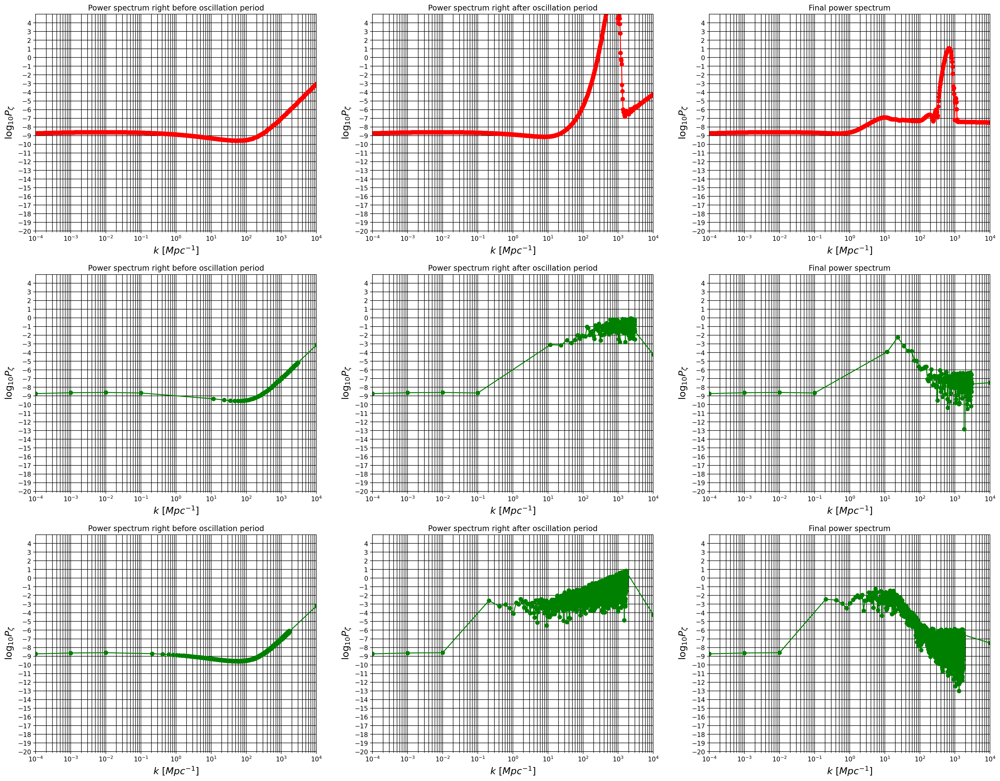

In [57]:
%matplotlib inline
%config InlineBackend.figure_formats = {'png', 'retina'}
import math
import numpy as np
import matplotlib.pyplot as plt


condition_name = ["zs_true-ps_true-ls_false-lks_false-kfrom_0.0001-kto_10000.0-iknum_1",
 "zs_true-ps_true-ls_true-kfrom_0.0001-kto_10000.0-iknum_100-kfroml_1-ktol_3000-N_512-dim_1",
                  "zs_true-ps_true-ls_true-kfrom_0.0001-kto_10000.0-iknum_100-kfroml_0.1-ktol_1700-N_16384-dim_1"]
color = ["r","g","g"]
graphrow, graphcolumn = len(condition_name) , 3

ymin = -20
ymax = 5
PSlabel = r"$ \log_{10}P_{\zeta}$"

fig = plt.figure(figsize=(graphcolumn*9, graphrow*7))# figsize=(width, height)

for num in range(len(condition_name)):
    mode_bfosc, PS_bfosc = np.loadtxt(parset_name + "/" + condition_name[num] + "/spectrum_bfosc.txt", usecols = (2,4), unpack=True) # 2:k 4:log10PR 
    mode_afosc, PS_afosc = np.loadtxt(parset_name + "/" + condition_name[num] + "/spectrum_afosc.txt", usecols = (2,4), unpack=True) # 2:k 4:log10PR 
    mode_final, PS_final = np.loadtxt(parset_name + "/" + condition_name[num] + "/spectrum_final.txt", usecols = (2,4), unpack=True) # 2:k 4:log10PR 

    ax = fig.add_subplot(graphrow, graphcolumn, 3*num+1)
    ax.plot(mode_bfosc, PS_bfosc, "-", color=color[num], label=PSlabel, marker='o') #r"$ \log_{10}P_{R}   $"
    # ax.set_xlim(0, 1000)
    ax.set_xlim(mode_bfosc[0], mode_bfosc[-1])
    ax.set_ylim(ymin, ymax)
    ax.set_xlabel("$k$ [$Mpc^{-1}$]", size = 15)
    ax.set_ylabel(PSlabel, size = 15)
    ax.set_yticks(np.arange(ymin, ymax, 1) )
    ax.title.set_text('Power spectrum right before oscillation period')
    plt.xscale('log')
    plt.grid(which='major',color='black',linestyle='-')
    plt.grid(which='minor',color='black',linestyle='-')

    bx = fig.add_subplot(graphrow, graphcolumn, 3*num+2)
    bx.plot(mode_afosc, PS_afosc, "-", color=color[num], label=PSlabel, marker='o') #r"$ \log_{10}P_{R}   $"
    # bx.set_xlim(0, 1000)
    bx.set_xlim(mode_afosc[0], mode_afosc[-1])
    bx.set_ylim(ymin, ymax)
    bx.set_xlabel("$k$ [$Mpc^{-1}$]", size = 15)
    bx.set_ylabel(PSlabel, size = 15)
    bx.set_yticks(np.arange(ymin, ymax, 1) )
    bx.title.set_text('Power spectrum right after oscillation period')
    plt.xscale('log')
    plt.grid(which='major',color='black',linestyle='-')
    plt.grid(which='minor',color='black',linestyle='-')

    cx = fig.add_subplot(graphrow, graphcolumn, 3*num+3)
    cx.plot(mode_final, PS_final, "-", color=color[num], label=PSlabel, marker='o') #r"$ \log_{10}P_{R}   $"
    # cx.set_xlim(0, 1000)
    cx.set_xlim(mode_final[0], mode_final[-1])
    cx.set_ylim(ymin, ymax)
    cx.set_xlabel("$k$ [$Mpc^{-1}$]", size = 15)
    cx.set_ylabel(PSlabel, size = 15)
    cx.set_yticks(np.arange(ymin, ymax, 1) )
    cx.title.set_text('Final power spectrum')
    plt.xscale('log')
    plt.grid(which='major',color='black',linestyle='-')
    plt.grid(which='minor',color='black',linestyle='-')

plt.show()

## 11. Lattice simulation and non-lattice simulation results comparison
---
#### Calculated mode range for non-lattice simulation:
   - Minimum: kfrom_Mpc_lattice = $10^{-4}$
   - Max: kto_Mpc_lattice = 400 
   - Grid Number: N = 2048
   
#### Calculated mode range and parameters for lattice simulation: 
  - Non-lattice range:
       - Minimum: kfrom_Mpc = $10^{-4}$ (knum = 0)
       - Max: kto_Mpc = $10^{4}$ (knum = 800)
       - Interval: kinterval_knum = 100
  - Lattice range: 
     - Grid Number: N = 2048
       - Minimum: kfrom_Mpc_lattice = $10^{-4}$
       - Max: kto_Mpc_lattice = 400 
       - Dimension: dim = 1 

In [68]:
%matplotlib inline
%config InlineBackend.figure_formats = {'png', 'retina'}
import math
import numpy as np
import matplotlib.pyplot as plt

# kMpc_105469
kMpc_int = 105469
kMpc =  kMpc_int/100

condition_name = ["zs_true-ps_true-ls_false-lks_true-kfroml_1-ktol_3000-N_512",#Non-lattice simulation
                  "zs_true-ps_true-ls_true-kfrom_0.0001-kto_10000.0-iknum_100-kfroml_1-ktol_3000-N_512-dim_1"]#Lattice simulation

#Non-lattice simulation
loga, w, Pzeta, PPot, log10_rhopdivrho, log10_Hdiva, log10_kdivaH, Psigma, Ppsi, Pphi, log10_dsigma, log10_dpsi, log10_dphi,\
zeta0_portion, zeta1_portion, zeta2_portion, zeta3_portion, zeta4_portion, zeta5_portion, sigma, psi, phi,\
sigma_dot, psi_dot, phi_dot, rho, Kinetic, Potential, rho_rad, dda, epsilon,d_11_re, d_12_re, d_13_re, d_21_re, d_22_re, d_23_re, d_31_re, d_32_re, d_33_re, d_11_p_re, d_12_p_re, d_13_p_re,\
d_21_p_re, d_22_p_re, d_23_p_re, d_31_p_re, d_32_p_re, d_33_p_re, Phi_1_re, Phi_2_re, Phi_3_re, Phi_1_p_re, Phi_2_p_re, Phi_3_p_re,\
d_11_im, d_12_im, d_13_im, d_21_im, d_22_im, d_23_im, d_31_im, d_32_im, d_33_im, d_11_p_im, d_12_p_im, d_13_p_im, d_21_p_im, d_22_p_im, d_23_p_im,\
d_31_p_im, d_32_p_im, d_33_p_im, Phi_1_im, Phi_2_im, Phi_3_im, Phi_1_p_im, Phi_2_p_im, Phi_3_p_im = np.loadtxt(parset_name  + "/" + condition_name[0] + "/k-analyze_nonlattice/kMpc_" \
+ str(kMpc_int) + ".txt", unpack=True)

#Lattice simulation
loga_lattice, w_lattice, Pzeta_lattice, PPot_lattice, log10_rhopdivrho_lattice, log10_Hdiva_lattice, log10_kdivaH_lattice, \
Psigma_lattice, Ppsi_lattice, Pphi_lattice, log10_dsigma_lattice, log10_dpsi_lattice, log10_dphi_lattice, \
zeta0_portion_lattice, zeta1_portion_lattice, zeta2_portion_lattice, zeta3_portion_lattice, zeta4_portion_lattice, zeta5_portion_lattice, \
sigma_lattice, psi_lattice, phi_lattice, sigma_dot_lattice, psi_dot_lattice, phi_dot_lattice, \
rho_lattice, Kinetic_lattice, Potential_lattice, rho_rad_lattice, dda_lattice, epsilon_lattice,\
d_11_re_lattice, d_12_re_lattice, d_13_re_lattice, d_21_re_lattice, d_22_re_lattice, d_23_re_lattice, d_31_re_lattice, d_32_re_lattice, d_33_re_lattice,\
d_11_p_re_lattice, d_12_p_re_lattice, d_13_p_re_lattice, d_21_p_re_lattice, d_22_p_re_lattice, d_23_p_re_lattice, d_31_p_re_lattice, d_32_p_re_lattice,\
d_33_p_re_lattice, Phi_1_re_lattice, Phi_2_re_lattice, Phi_3_re_lattice, Phi_1_p_re_lattice, Phi_2_p_re_lattice, Phi_3_p_re_lattice, \
d_11_im_lattice, d_12_im_lattice, d_13_im_lattice, d_21_im_lattice, d_22_im_lattice, d_23_im_lattice, d_31_im_lattice, d_32_im_lattice, d_33_im_lattice,\
d_11_p_im_lattice, d_12_p_im_lattice, d_13_p_im_lattice, d_21_p_im_lattice, d_22_p_im_lattice, d_23_p_im_lattice,\
d_31_p_im_lattice, d_32_p_im_lattice, d_33_p_im_lattice, Phi_1_im_lattice, Phi_2_im_lattice, Phi_3_im_lattice, Phi_1_p_im_lattice, Phi_2_p_im_lattice, Phi_3_p_im_lattice \
= np.loadtxt(parset_name  + "/" +  condition_name[1] +"/k-analyze_lattice/kMpc_"\
+ str(kMpc_int) + ".txt", unpack=True)
#0:loga, 2: Pzeta, 3: PPot, 7:Psigma, 8:Ppsi, 9:Pphi

graphrow, graphcolumn = 21, 2

fig = plt.figure(figsize=(graphcolumn*9, graphrow*7))# figsize=(width, height)

xvariable = loga
xlabel = "N"

ax1 = fig.add_subplot(graphrow, graphcolumn,1)
ax1.plot(loga, Psigma, "-", color="m", label=r"$ log P_{\delta\sigma}  $")
# ax1.plot(loga, Ppsi, "-", color="g", label=r"$  log P_{\delta\psi}  $")
# ax1.plot(loga, Pphi, "-", color="b", label=r"$  log P_{\delta\phi}  $")
ax1.plot(loga_lattice, Psigma_lattice, "-", color="r", label=r"$ log P_{\delta\sigma} \ (lattice)   $")
ax1.axvline(x=OSCSTART, color='k')
ax1.axvline(x=OSCEND, color='k')
ax1.axvline(x=UNPERT, color='k')
# ax1.set_xlim(0, 1000)
ax1.set_xlim(loga_lattice[0], loga_lattice[-1])
ax1.set_ylim(-35,0)
ax1.set_xlabel("ln a", size = 15)
ax1.set_ylabel(r"$ \log P_{\delta\sigma} $", size = 15)
ax1.legend(loc="upper right")
ax1.title.set_text(r'$log P_{\delta\sigma}$ Comparison: kMpc = '+ str(kMpc))

bx1 = fig.add_subplot(graphrow, graphcolumn,2)
bx1.plot(loga_lattice, Psigma_lattice, "-", color="r", label=r"$ log P_{\delta\sigma}  $")
# bx1.plot(loga_lattice, Ppsi_lattice, "-", color="g", label=r"$  log P_{\delta\psi}  $")
# bx1.plot(loga_lattice, Pphi_lattice, "-", color="b", label=r"$  log P_{\delta\phi}  $")
bx1.axvline(x=OSCSTART, color='k')
bx1.set_xlim(OSCSTART-0.5, OSCSTART+0.5)
bx1.set_ylim(-35,0)
bx1.set_xlabel("ln a", size = 15)
bx1.set_ylabel(r"$ \log P_{\delta\sigma} $", size = 15)
bx1.legend(loc="upper right")
bx1.title.set_text('Lattice Simulation (Close Up): kMpc = '+ str(kMpc))

ax2 = fig.add_subplot(graphrow, graphcolumn,3)
# ax2.plot(loga, Psigma, "-", color="r", label=r"$ log P_{\delta\sigma}  $")
ax2.plot(loga, Ppsi, "-", color="m", label=r"$  log P_{\delta\psi}  $")
# ax2.plot(loga, Pphi, "-", color="b", label=r"$  log P_{\delta\phi}  $")
ax2.plot(loga_lattice, Ppsi_lattice, "-", color="g", label=r"$  log P_{\delta\psi} \ (lattice)   $")
ax2.axvline(x=OSCSTART, color='k')
ax2.axvline(x=OSCEND, color='k')
ax2.axvline(x=UNPERT, color='k')
# ax2.set_xlim(0, 1000)
ax2.set_xlim(loga_lattice[0], loga_lattice[-1])
ax2.set_ylim(-35,0)
ax2.set_xlabel("ln a", size = 15)
ax2.set_ylabel(r"$ \log P_{\delta\psi} $", size = 15)
ax2.legend(loc="upper right")
ax2.title.set_text(r'$log P_{\delta\psi}$ Comparison: kMpc = '+ str(kMpc))

bx2 = fig.add_subplot(graphrow, graphcolumn,4)
# bx2.plot(loga_lattice, Psigma_lattice, "-", color="r", label=r"$ log P_{\delta\sigma}  $")
bx2.plot(loga_lattice, Ppsi_lattice, "-", color="g", label=r"$  log P_{\delta\psi}  $")
# bx2.plot(loga_lattice, Pphi_lattice, "-", color="b", label=r"$  log P_{\delta\phi}  $")
bx2.axvline(x=OSCSTART, color='k')
# bx2.set_xlim(0, 1000)
bx2.set_xlim(OSCSTART-0.5, OSCSTART+0.5)
bx2.set_ylim(-35,0)
bx2.set_xlabel("ln a", size = 15)
bx2.set_ylabel(r"$ \log P_{\delta\psi} $", size = 15)
bx2.legend(loc="upper right")
bx2.title.set_text('Lattice Simulation (Close Up): kMpc = '+ str(kMpc))

cx = fig.add_subplot(graphrow, graphcolumn,5)
# cx.plot(loga, Psigma, "-", color="r", label=r"$ log P_{\delta\sigma}  $")
# cx.plot(loga, Ppsi, "-", color="g", label=r"$  log P_{\delta\psi}  $")
cx.plot(loga, Pphi, "-", color="m", label=r"$  log P_{\delta\phi}  $")
cx.plot(loga_lattice, Pphi_lattice, "-", color="b", label=r"$  log P_{\delta\phi} \ (lattice)  $")
cx.axvline(x=OSCSTART, color='k')
cx.axvline(x=OSCEND, color='k')
cx.axvline(x=UNPERT, color='k')
cx.set_xlim(loga_lattice[0], loga_lattice[-1])
cx.set_ylim(-35,0)
cx.set_xlabel("ln a", size = 15)
cx.set_ylabel(r"$ \log P_{\delta\phi} $", size = 15)
cx.legend(loc="upper right")
cx.title.set_text(r'$log P_{\delta\phi}$ Comparison: kMpc = '+ str(kMpc))

cx2 = fig.add_subplot(graphrow, graphcolumn,6)
# cx2.plot(loga_lattice, Psigma_lattice, "-", color="r", label=r"$ log P_{\delta\sigma}  $")
#cx2.plot(loga_lattice, Ppsi_lattice, "-", color="g", label=r"$  log P_{\delta\psi}  $")
cx2.plot(loga_lattice, Pphi_lattice, "-", color="b", label=r"$  log P_{\delta\phi}  $")
cx2.axvline(x=OSCSTART, color='k')
cx2.set_xlim(OSCSTART-0.5, OSCSTART+0.5)
cx2.set_ylim(-35,0)
cx2.set_xlabel("ln a", size = 15)
cx2.set_ylabel(r"$ \log P_{\delta\phi} $", size = 15)
cx2.legend(loc="upper right")
cx2.title.set_text('Lattice Simulation (Close Up): kMpc = '+ str(kMpc))

dx = fig.add_subplot(graphrow, graphcolumn, 7 )
dx.plot(loga, PPot, "-", color="r", label=r"$ log P_{\Phi} $")
dx.plot(loga_lattice, PPot_lattice, "-", color="g", label=r"$ log P_{\Phi} \ (lattice) $")
dx.plot(loga, Pzeta, "-", color="b", label=r"$log P_{R}  $")
dx.plot(loga_lattice, Pzeta_lattice, "-", color="y", label=r"$ log P_{R} \ (lattice) $")
dx.axvline(x=OSCSTART, color='k')
dx.axvline(x=OSCEND, color='k')
dx.axvline(x=UNPERT, color='k')
dx.set_xlim(loga_lattice[0], loga_lattice[-1])
dx.set_ylim(-25,10)
dx.set_xlabel("ln a", size = 15)
dx.set_ylabel(r"$ \log P $", size = 15)
dx.legend(loc="upper right")
dx.title.set_text(r'$log P_{R}$ and $log P_{\Phi}$ Comparison: kMpc = '+ str(kMpc))


dx2 = fig.add_subplot(graphrow, graphcolumn, 8 )
# dx2.plot(loga, Pzeta_lattice, "-", color="r", label=r"$log P_{R}  $")
dx2.plot(loga_lattice, PPot_lattice, "-", color="g", label=r"$ log P_{\Phi} $")
dx2.plot(loga_lattice, Pzeta_lattice, "-", color="y", label=r"$ log P_{R} $")
dx2.axvline(x=OSCSTART, color='k')
dx2.axvline(x=OSCEND, color='k')
dx2.axvline(x=UNPERT, color='k')
dx2.set_xlim(OSCSTART-0.5, OSCSTART+0.5)
dx2.set_ylim(-25,10)
dx2.set_xlabel("ln a", size = 15)
dx2.set_ylabel(r"$ \log P $", size = 15)
dx2.legend(loc="upper right")
dx2.title.set_text('Lattice Simulation (Close Up): kMpc = '+ str(kMpc))

ex = fig.add_subplot(graphrow, graphcolumn, 9)
ex.plot(loga, log10_dsigma, "-", color="r", label=r"$ |\sigma_{k}| $")
ex.plot(loga, log10_dpsi, "-", color="g", label=r"$   |\psi_{k}|  $")
ex.plot(loga, log10_dphi, "-", color="b", label=r"$   |\phi_{k}|  $")
ex.axvline(x=OSCSTART, color='k')
ex.axvline(x=OSCEND, color='k')
ex.axvline(x=UNPERT, color='k')
ex.set_xlim(loga[0], loga[-1])
ex.set_ylim(70,85)
ex.set_xlabel("ln a", size = 15)
ex.set_ylabel(r"$ |F_{k}| $", size = 15)
ex.legend(loc="lower right")
ex.title.set_text('Non-lattice Simulation: kMpc = '+ str(kMpc))

#left column
#1st row (eg. d_11_re, d_12_re, d_13_re)
nl_pert_re = [d_11_re, d_12_re, d_13_re, d_21_re, d_22_re, d_23_re, d_31_re, d_32_re, d_33_re, Phi_1_re, Phi_2_re, Phi_3_re]
#2nd row (eg. d_11_im, d_12_im, d_13_im)
nl_pert_im = [d_11_im, d_12_im, d_13_im, d_21_im, d_22_im, d_23_im, d_31_im, d_32_im, d_33_im, Phi_1_im, Phi_2_im, Phi_3_im]
#3rd row (eg. d_11_p_re, d_12_p_re, d_13_p_re)
nl_pert_p_re = [d_11_p_re, d_12_p_re, d_13_p_re, d_21_p_re, d_22_p_re, d_23_p_re, d_31_p_re, d_32_p_re, d_33_p_re, Phi_1_re, Phi_2_re, Phi_3_re]
#4th row (eg. d_11_p_im, d_12_p_im, d_13_p_im)
nl_pert_p_im = [d_11_p_im, d_12_p_im, d_13_p_im, d_21_p_im, d_22_p_im, d_23_p_im, d_31_p_im, d_32_p_im, d_33_p_im, Phi_1_p_im, Phi_2_p_im, Phi_3_p_im]



#right column
#1st row
l_pert_re =  [d_11_re_lattice, d_12_re_lattice, d_13_re_lattice, d_21_re_lattice, d_22_re_lattice, d_23_re_lattice, d_31_re_lattice, d_32_re_lattice, d_33_re_lattice,  Phi_1_re_lattice, Phi_2_re_lattice, Phi_3_re_lattice]
#2nd row
l_pert_im = [d_11_im_lattice, d_12_im_lattice, d_13_im_lattice, d_21_im_lattice, d_22_im_lattice, d_23_im_lattice, d_31_im_lattice, d_32_im_lattice, d_33_im_lattice, Phi_1_im_lattice, Phi_2_im_lattice, Phi_3_im_lattice]
#3rd row
l_pert_p_re = [d_11_p_re_lattice, d_12_p_re_lattice, d_13_p_re_lattice, d_21_p_re_lattice, d_22_p_re_lattice, d_23_p_re_lattice, d_31_p_re_lattice, d_32_p_re_lattice, d_33_p_re_lattice, Phi_1_re_lattice, Phi_2_re_lattice, Phi_3_re_lattice]
#4th row
l_pert_p_im =  [d_11_p_im_lattice, d_12_p_im_lattice, d_13_p_im_lattice, d_21_p_im_lattice, d_22_p_im_lattice, d_23_p_im_lattice, d_31_p_im_lattice, d_32_p_im_lattice, d_33_p_im_lattice, Phi_1_p_im_lattice, Phi_2_p_im_lattice, Phi_3_p_im_lattice]

label_re = [r"$Re\psi_{11}$",r"$Re\psi_{12}$",r"$Re\psi_{13}$",r"$Re\psi_{21}$",r"$Re\psi_{22}$",r"$Re\psi_{23}$",r"$Re\psi_{31}$",r"$Re\psi_{32}$",r"$Re\psi_{33}$",r"$Re(f_{1})$",r"$Re(f_{2})$",r"$Re(f_{3})$"]
label_im = [r"$Im\psi_{11}$",r"$Im\psi_{12}$",r"$Im\psi_{13}$",r"$Im\psi_{21}$",r"$Im\psi_{22}$",r"$Im\psi_{23}$",r"$Im\psi_{31}$",r"$Im\psi_{32}$",r"$Im\psi_{33}$",r"$Im(f_{1})$",r"$Im(f_{2})$",r"$Im(f_{3})$"]
label_p_re = [r"$Re\dot{\psi}_{11}$",r"$Re\dot{\psi}_{12}$",r"$Re\dot{\psi}_{13}$",r"$Re\dot{\psi}_{21}$",r"$Re\dot{\psi}_{22}$",r"$Re\dot{\psi}_{23}$",r"$Re\dot{\psi}_{31}$",r"$Re\dot{\psi}_{32}$",r"$Re\dot{\psi}_{33}$",r"$Re(\dot{f}_{1})$",r"$Re(\dot{f}_{2})$",r"$Re(\dot{f}_{3})$"]
label_p_im = [r"$Im\dot{\psi}_{11}$",r"$Im\dot{\psi}_{12}$",r"$Im\dot{\psi}_{13}$",r"$Im\dot{\psi}_{21}$",r"$Im\dot{\psi}_{22}$",r"$Im\dot{\psi}_{23}$",r"$Im\dot{\psi}_{31}$",r"$Im\dot{\psi}_{32}$",r"$Im\dot{\psi}_{33}$",r"$Im(\dot{f}_{1})$",r"$Im(\dot{f}_{2})$",r"$Im(\dot{f}_{3})$"]
ylabels = [r"$Re\psi_{ij} $",r"$Re(f_{i}) $",r"$Im\psi_{ij} $",r"$Im(f_{i}) $",r"$Re\dot{\psi}_{ij} $",r"$Re(\dot{f}_{i}) $",r"$Im\dot{\psi}_{ij} $",r"$Im(\dot{f}_{i}) $"]



col_num = int((len(nl_pert_re)/3)*4)#16 32plots

for num in range(col_num):#0~15
    field_num = num // 4
    array_num = num % 4
    if field_num == 3:   
        ylabel = ylabels[2*array_num+1]
    else:
        ylabel = ylabels[2*array_num]
    if array_num == 0:
        abs_var1 = np.abs(nl_pert_re[3*field_num])
        abs_var2 = np.abs(nl_pert_re[3*field_num+1])
        abs_var3 = np.abs(nl_pert_re[3*field_num+2])
        abs_var1_l = np.abs(l_pert_re[3*field_num])
        abs_var2_l = np.abs(l_pert_re[3*field_num+1])
        abs_var3_l = np.abs(l_pert_re[3*field_num+2])
        labelarray = label_re
    elif array_num == 1:
        abs_var1 = np.abs(nl_pert_im[3*field_num])
        abs_var2 = np.abs(nl_pert_im[3*field_num+1])
        abs_var3 = np.abs(nl_pert_im[3*field_num+2])
        abs_var1_l = np.abs(l_pert_im[3*field_num])
        abs_var2_l = np.abs(l_pert_im[3*field_num+1])
        abs_var3_l = np.abs(l_pert_im[3*field_num+2])
        labelarray = label_im
    elif array_num == 2:
        abs_var1 = np.abs(nl_pert_p_re[3*field_num])
        abs_var2 = np.abs(nl_pert_p_re[3*field_num+1])
        abs_var3 = np.abs(nl_pert_p_re[3*field_num+2])
        abs_var1_l = np.abs(l_pert_p_re[3*field_num])
        abs_var2_l = np.abs(l_pert_p_re[3*field_num+1])
        abs_var3_l = np.abs(l_pert_p_re[3*field_num+2])
        labelarray = label_p_re
    elif array_num == 3:
        abs_var1 = np.abs(nl_pert_p_im[3*field_num])
        abs_var2 = np.abs(nl_pert_p_im[3*field_num+1])
        abs_var3 = np.abs(nl_pert_p_im[3*field_num+2])
        abs_var1_l = np.abs(l_pert_p_im[3*field_num])
        abs_var2_l = np.abs(l_pert_p_im[3*field_num+1])
        abs_var3_l = np.abs(l_pert_p_im[3*field_num+2])
        labelarray = label_p_im

        
    fx = fig.add_subplot(graphrow, graphcolumn, 11+2*num)
    fx.plot(loga, abs_var1, "-", color="r", label="|"+labelarray[3*field_num]+"|")
    fx.plot(loga, abs_var2, "-", color="g", label="|"+labelarray[3*field_num+1]+"|")
    fx.plot(loga, abs_var3, "-", color="b", label="|"+labelarray[3*field_num+2]+"|")
    fx.axvline(x=OSCSTART, color='k')
    fx.axvline(x=OSCEND, color='k')
    fx.axvline(x=UNPERT, color='k')
    fx.set_xlim(loga[0], -110)
    fx.set_xlabel("ln a", size = 15)
    fx.set_ylabel("|"+ylabel+"|", size = 15)
    fx.legend(loc="upper right")
    fx.title.set_text('Non-lattice Simulation: kMpc = '+ str(kMpc))
    fx.set_yscale('log')
    fx.grid()

    fx2 = fig.add_subplot(graphrow, graphcolumn, 11+2*num+1)
    fx2.plot(loga_lattice, abs_var1_l, "-", color="c", label="|"+labelarray[3*field_num]+"|")
    fx2.plot(loga_lattice, abs_var2_l, "-", color="m", label="|"+labelarray[3*field_num+1]+"|")
    fx2.plot(loga_lattice, abs_var3_l, "-", color="y", label="|"+labelarray[3*field_num+2]+"|")
    fx2.axvline(x=OSCSTART, color='k')
    fx2.axvline(x=OSCEND, color='k')
    fx2.axvline(x=UNPERT, color='k')
    fx2.set_xlim(loga[0], -110)
    fx2.set_xlabel("ln a", size = 15)
    fx2.set_ylabel("|"+ylabel+"|", size = 15)
    fx2.legend(loc="upper right")
    fx2.title.set_text('Lattice Simulation: kMpc = '+ str(kMpc))
    fx2.set_yscale('log')
    fx2.grid()


plt.show()
